In [5]:
import numpy as np
import pandas as pd
import json

In [6]:
from gensim.models import KeyedVectors

In [7]:
def save_dict_to_json(file, data):
    with open(file, 'w') as f:
        json.dump(data, f)

In [8]:
def load_dict_from_json(file):
    with open(file, 'r') as f:
        data = json.load(f)
    
    return data

In [9]:
def read_stop_words(file):
    with open(file) as f:
        stop_words = f.read().split('\n')

    return stop_words

In [10]:
uk_stop_words = read_stop_words('/home/dbabenko/DS/Detect-emotion-sentimental/data/ukrainian-stopwords.txt')

In [30]:
embeddings_file = "data/ubercorpus.lowercased.tokenized.word2vec.300d"

In [31]:
word2vec = KeyedVectors.load_word2vec_format(embeddings_file)

In [11]:
train_dict = load_dict_from_json('data/train-tokens.json')
X_train_tokens = train_dict['tokens']
y_train = train_dict['label']
del train_dict

test_dict = load_dict_from_json('data/test-tokens.json')
X_test_tokens = test_dict['tokens']
y_test = test_dict['label']
del test_dict

# Task 1 - classification

In [38]:
import gzip
import glob
import json
import os
import tokenize_uk

In [13]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

## Data

### Load data

In [8]:
def read_zfile(file):
    with gzip.open(file, 'rt') as f:
        return json.load(f.read())

In [9]:
def read_file(f):
    with gzip.open(f, 'rt', encoding='utf-8') as inf:
        j = json.load(inf)
        text = j[0]['CallZText']
        return text, j[0]['CallZType']
#         if is_uk_language(text):
#             return text, j[0]['CallZType']

In [10]:
def read_all_zip_files_from_dir(dir_path):
    data = []
    for f in glob.glob(f"{dir_path}/*/*"):
        data.append(read_file(f))
    return data

In [12]:
data = read_all_zip_files_from_dir("data/1551.gov.ua/raw")

In [13]:
data = np.array(data)

In [14]:
len(data)

127329

##### filter emty data

In [15]:
data = np.array([item for item in data if len(item[0]) > 0])

In [16]:
len(data)

126789

### Analyze data

In [17]:
from plotly.offline import iplot
import cufflinks
cufflinks.go_offline()
cufflinks.set_config_file(world_readable=True, theme='pearl')

In [18]:
X_text = data[:, 0]
y = data[:, 1]

In [19]:
labels = np.unique(y)
print(f"There are {len(labels)} classes.")

There are 918 classes.


In [20]:
df = pd.DataFrame({
    'text' : X_text,
    'label' : y
})

In [21]:
df.head()

,text,label
0,Квартира 2х комнатная нет отопления в кухне ме...,Відсутність опалення по стояку
1,Щодня дорогою на роботу та з роботи доволиться...,Робота світлофора
2,"Приберіть сміття біля будинку №4, а саме за б...",Прибирання та санітарний стан територій
3,прошу повідомити чому відсутнє по над тиждень ...,Відсутність освітлення у під’їзді за відсутнос...
4,"Немає освітлення над входом до 2, 3 та 4 під”ї...",Освітлення в приміщенні й при вході в нього


In [22]:
df['label'].iplot(
    kind='hist',
    bins=5,
    xTitle='rating',
    linecolor='black',
    yTitle='count',
    title='Label count distribution')

In [23]:
def calc_label_counter(y):
    label_counter_dict = dict()
    for yi in y:
        if yi not in label_counter_dict:
            label_counter_dict[yi] = 1
        else:
            label_counter_dict[yi] += 1
    return sorted(label_counter_dict.items(), key=lambda item: item[1], reverse=True)

In [24]:
label_counter = calc_label_counter(y)

In [25]:
one_label = [item for item in label_counter if item[1] < 2]

In [26]:
len(one_label)

124

In [27]:
max_ten_label = [item for item in label_counter if item[1] <= 10]

In [28]:
len(max_ten_label)

437

In [29]:
label_counter[0][1]

13253

In [30]:
more_100_label_items = [item for item in label_counter if item[1] >= 100]

In [31]:
more_100_labels = np.array(more_100_label_items)[:,0]

In [32]:
len(more_100_labels)

187

Let's consider only data where we have more than 100 different text for each label.

In [33]:
more_100_data = np.array([item for item in data if item[1] in more_100_labels])

In [34]:
len(more_100_data)

114222

In [35]:
X_text = more_100_data[:,0]
y = more_100_data[:,1]

In [37]:
import langdetect
from typing import Dict
from gensim.models.keyedvectors import Word2VecKeyedVectors
from fuzzyset import FuzzySet

#### filter non-ukrainian language

In [7]:
import tokenize_uk

In [70]:
def is_uk_language(text):
    try:
        if langdetect.detect(text) == 'uk':
            return True
    except:
        return False

    return False

In [33]:
def filter_non_ukrainian_text(X, y):
    assert len(X) == len(y)
    filtered_X, filtered_y = [], []
    for i in range(0, len(X)):
        if is_uk_language(X[i]):
            filtered_X.append(X[i])
            filtered_y.append(y[i])
            
    return filtered_X, filtered_y

In [34]:
def filter_by_labels(X, y, labels):
    assert len(X) == len(y)
    filtered_X, filtered_y = [], []
    for i in range(0, len(X)):
        if y[i] in labels:
            filtered_X.append(X[i])
            filtered_y.append(y[i])
            
    return filtered_X, filtered_y 

In [35]:
X_uk_text, y_uk = filter_non_ukrainian_text(X_text, y)

In [42]:
len(X_uk_text)

61743

In [43]:
label_counter = calc_label_counter(y_uk)

In [44]:
more_100_labels = [item[0] for item in label_counter if item[1] >= 100]

**Let's consider only lables which has more than 100 examples of text**

In [45]:
X_text, y = filter_by_labels(X_uk_text, y_uk, more_100_labels)

In [46]:
df = pd.DataFrame({
    'text' : X_text,
    'label' : y})

In [47]:
df.to_csv('data/1551-uk.csv', index=False)

In [32]:
df = pd.read_csv('data/1551-uk.csv')

In [33]:
df.head()

,text,label
0,Щодня дорогою на роботу та з роботи доволиться...,Робота світлофора
1,"Приберіть сміття біля будинку №4, а саме за б...",Прибирання та санітарний стан територій
2,прошу повідомити чому відсутнє по над тиждень ...,Відсутність освітлення у під’їзді за відсутнос...
3,"Немає освітлення над входом до 2, 3 та 4 під”ї...",Освітлення в приміщенні й при вході в нього
4,"Сьогодні в черговий раз зламався, і не працює...",Не працює вантажний ліфт


In [34]:
X_text = df['text'].values

In [35]:
y = df['label'].values

#### Split data into train and test 

In [40]:
X_train, X_test, y_train, y_test = train_test_split(X_text, y, test_size=0.30, random_state=42)

**Let's work only with train data for all experiments and check the result on test**

In [42]:
def write_sentences_to_file(file, text_list):
    with open(file, 'w') as f:
        for text in text_list:
            sents = tokenize_uk.tokenize_sents(text)
            for sent in sents:
                f.write("%s\n" % sent)

In [43]:
write_sentences_to_file('data/1551-uk-sentences.txt', X_text) #these sentences will be used for continue training word embedings

# Baseline

In [44]:
from sklearn.neighbors import KNeighborsClassifier

In [45]:
def vectorize(text):
    words = tokenize_uk.tokenize_words(text)
    v = np.array(300 * [0.0])
    for w in words:
        w = w.lower()
        if w in word2vec:
            v += word2vec[w]
    v /= len(words)
    return v

In [46]:
X_train_vec = [vectorize(x) for x in X_train]

In [47]:
X_test_vec = [vectorize(x) for x in X_test]

In [48]:
knn_model = KNeighborsClassifier(n_neighbors=5, metric='cosine')

In [49]:
knn_model.fit(X_train_vec, y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='cosine',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [50]:
y_pred = knn_model.predict(X_test_vec)

In [51]:
print(classification_report(y_test, y_pred))

                                                                                  precision    recall  f1-score   support

                                                                     Інші Подяки       0.40      0.23      0.29        95
                                              Інші технічні недоліки стану ліфту       0.17      0.51      0.26       210
                Аварійний, травмонебезпечний стан утримання об’єктів благоустрою       0.09      0.13      0.11        90
                                    Будівництво та реконструкція об’єктів освіти       0.51      0.52      0.52        44
                                  Будівництво/дооблаштування дитячого майданчику       0.28      0.69      0.39       204
                                Видалення аварійних, пошкоджених хворобами дерев       0.27      0.32      0.30       108
                                                      Вилов безпритульних тварин       0.42      0.54      0.48        35
                       

##### Let's define baseline F1-score (macro avg): 0.25.

# Improve baseline

### Multilayer Perceptron

In [344]:
from sklearn.neural_network import MLPClassifier

In [349]:
mlp = MLPClassifier(hidden_layer_sizes=(256,128, 128),
                    activation='relu',
                    solver='adam',
                    alpha=0.2,
                    learning_rate_init=0.1,
                    max_iter=50)

In [350]:
mlp.fit(X_train_vec, y_train)

MLPClassifier(activation='relu', alpha=0.2, batch_size='auto', beta_1=0.9,
              beta_2=0.999, early_stopping=False, epsilon=1e-08,
              hidden_layer_sizes=(256, 128, 128), learning_rate='constant',
              learning_rate_init=0.1, max_fun=15000, max_iter=50, momentum=0.9,
              n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
              random_state=None, shuffle=True, solver='adam', tol=0.0001,
              validation_fraction=0.1, verbose=False, warm_start=False)

In [351]:
y_test_pred = mlp.predict(X_test_vec)

In [352]:
print(classification_report(y_test, y_pred))

                                                                                  precision    recall  f1-score   support

                                                                     Інші Подяки       0.40      0.23      0.29        95
                                              Інші технічні недоліки стану ліфту       0.17      0.51      0.26       210
                Аварійний, травмонебезпечний стан утримання об’єктів благоустрою       0.09      0.13      0.11        90
                                    Будівництво та реконструкція об’єктів освіти       0.51      0.52      0.52        44
                                  Будівництво/дооблаштування дитячого майданчику       0.28      0.69      0.39       204
                                Видалення аварійних, пошкоджених хворобами дерев       0.27      0.32      0.30       108
                                                      Вилов безпритульних тварин       0.42      0.54      0.48        35
                       

### Pre-process data

#### Fix incorrect written words

In [41]:
class WordFixer:

    def __init__(self, word2vec, fixed_word_dict = None):
        self.__word2vec = word2vec
        if fixed_word_dict is None:
            self.__fixed_word_dict: Dict[str, str] = dict()
        else:
            self.__fixed_word_dict: Dict[str, str] = fixed_word_dict

        self.__approximate_matcher = FuzzySet(word2vec.vocab)

    def is_word_correct(self, word: str):
        if word in self.__word2vec:
            return True
        return False

    def fix(self, word: str):

        if word in self.__fixed_word_dict:
            return self.__fixed_word_dict[word]

        candidate = self.__approximate_matcher.get(word)
        if candidate is not None and len(candidate) > 0:
            fixed_word = candidate[0][1]
            self.__fixed_word_dict[word] = fixed_word
            return fixed_word

        return None
    
    def count_fixed_words(self):
        return len(self.__fixed_word_dict)
    
    def get_fixed_word_dict(self):
        return self.__fixed_word_dict


In [42]:
with open('data/fixed_words.json') as json_file:
    fixed_word_dict = json.load(json_file)

In [43]:
len(fixed_word_dict)

63078

In [44]:
word_fixer = WordFixer(word2vec, fixed_word_dict)

In [45]:
word_fixer.fix('неправилно')

'неправильно'

In [46]:
word_fixer.fix('даеко')

'далеко'

In [47]:
word_fixer.count_fixed_words()

63078

#### ignore punctuationa and other pos tags

In [48]:
import pymorphy2
morph = pymorphy2.MorphAnalyzer(lang='uk')

In [49]:
def is_suitable_token(token, stop_words = []):
    token = token.lower()
    if token.isdigit():
        return False
    
    if token in stop_words:
        return False

    parse = morph.parse(token)[0]
    
    if parse.normal_form in stop_words:
        return False
    
    if parse.tag.POS in {'NUMR', 'NPRO', 'PREP', 'CONJ', 'PRCL'}:
        return False
    
    
    if 'UNKN' in parse.tag:
        return False
    
    if 'NUMB' in parse.tag:
        return False
    
    if 'PNCT' in parse.tag:
        return False

    
    return True


In [61]:
is_suitable_token('куди')

False

In [62]:
is_suitable_token('вода')

True

Let's vectorize text using pos filters and fix incorrect written words

In [63]:
def vectorize_with_filters(text):
    words = tokenize_uk.tokenize_words(text)
    v = np.array(300 * [0.0])
    count = 0
    for w in words:
        word = None
        if w in word2vec:
            word = w
        else:
            word = word_fixer.fix(w)
        
        if word:
            if is_suitable_token(word):
                v += word2vec[word]
                count += 1
    v /= count
    return v 

In [64]:
X_train_v = [vectorize_with_filters(x) for x in X_train]

In [65]:
X_test_v = [vectorize_with_filters(x) for x in X_test]

In [66]:
print(f"In general there are fixed {word_fixer.count_fixed_words()} incorrected written words.")

In general there are fixed 103160 incorrected written words.


In [67]:
knn_model.fit(X_train_v, y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='cosine',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [68]:
y_test_pred = knn_model.predict(X_test_v)

In [69]:
print(classification_report(y_test, y_test_pred))

                                                                                  precision    recall  f1-score   support

                                                                     Інші Подяки       0.43      0.33      0.37        95
                                              Інші технічні недоліки стану ліфту       0.24      0.47      0.32       210
                Аварійний, травмонебезпечний стан утримання об’єктів благоустрою       0.13      0.17      0.15        90
                                    Будівництво та реконструкція об’єктів освіти       0.42      0.50      0.45        44
                                  Будівництво/дооблаштування дитячого майданчику       0.38      0.79      0.52       204
                                Видалення аварійних, пошкоджених хворобами дерев       0.41      0.52      0.46       108
                                                      Вилов безпритульних тварин       0.63      0.83      0.72        35
                       

As we can see filter non-ukraninan language and fixing incorrectly written words improved classification compare to baseline, F1:score (macro avg): 0.30 > 0.27.

##### Use only lemma and filter non-ukranian words

*Previously, we filter non-ukranian text, but sometimes non-ukrainian words are presented.*

In [50]:
def get_lemma_if_suitable(token, stop_words = []):
    token = token.lower()
    if token.isdigit():
        return False, None
    
    if token in stop_words:
        return False, None

    parse = morph.parse(token)[0]
    
    if parse.normal_form in stop_words:
        return False, None
    
    if parse.tag.POS in {'NUMR', 'NPRO', 'PREP', 'CONJ', 'PRCL'}:
        return False, None
    
    
    if 'UNKN' in parse.tag:
        return False, None
    
    
    if 'NUMB' in parse.tag:
        return False, None
    
    if 'PNCT' in parse.tag:
        return False, None

    
    return True, parse.normal_form.lower()

In [51]:
import re
_digits = re.compile('\d')
a_z = re.compile('[a-z]')

In [52]:
bool(a_z.match("іваоріл"))

False

In [53]:
def contains_digits(d):
    return bool(_digits.search(d))

In [54]:
def contains_ansi(s):
    return bool(a_z.match(s))

In [58]:
def get_token_lemma_suitable(token, word2vec_fixer=word2vec):
    word = None
    if token in word2vec_fixer:
        word = token
    else:
        word = word_fixer.fix(token)
        
    if word is None:
        return False, None
        
    ret, lemma = get_lemma_if_suitable(word)
        
    if ret is False:
        return False, None
            
    if lemma not in word2vec_fixer:
        return False, None
    
    if lemma in uk_stop_words:
        return False, None
            
#     if is_uk_language(lemma) is False:
#         return False, None

    if contains_ansi(lemma):
        return False, None
    
    if contains_digits(lemma):
        return False, None
    
    
    return True, lemma

In [62]:
get_token_lemma_suitable('на')

(False, None)

In [63]:
def text_to_filtered_tokens(text, word2vec_fixer=word2vec):
    result = []
    words = tokenize_uk.tokenize_words(text)
    for w in words:
        ret, lemma = get_token_lemma_suitable(w, word2vec_fixer)
        if ret:
            result.append(lemma)
    return result

In [64]:
def convert_text_data_to_tokens(X, y):
    assert len(X) == len(y)
    new_X, new_y = [], []
    for i in range(0, len(X)):
        tokens = text_to_filtered_tokens(X[i])
        if len(tokens) == 0:
            continue
        
        new_X.append(tokens)
        new_y.append(y[i])
        
    return new_X, new_y

In [65]:
X_train_tokens, y_train = convert_text_data_to_tokens(X_train, y_train)

In [66]:
X_test_tokens, y_test = convert_text_data_to_tokens(X_test, y_test)

To save time for processing data in future experiments, let's save these processed data into file.

In [67]:
train_dict = {
    'tokens': X_train_tokens,
    'label' : y_train
}

In [68]:
save_dict_to_json('data/train-tokens.json', train_dict)

In [69]:
save_dict_to_json('data/test-tokens.json', {
    'tokens': X_test_tokens,
    'label' : y_test
})

In [149]:
def tokens2vector(tokens, wv):
    v = np.array(300 * [0.0])
    count = 0
    for token in tokens:
        if token in wv:
            v += wv[token]
    
    if count == 0:
        return v
    
    v /= count
    return  v

In [150]:
X_train_v = [tokens2vector(x, word2vec) for x in X_train_tokens]

In [151]:
X_test_v = [tokens2vector(x, word2vec) for x in X_test_tokens]

In [152]:
knn_model.fit(X_train_v, y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='cosine',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [153]:
y_test_pred = knn_model.predict(X_test_v)

In [154]:
print(classification_report(y_test, y_test_pred))

                                                                                  precision    recall  f1-score   support

                                                                     Інші Подяки       0.41      0.25      0.31        95
                                              Інші технічні недоліки стану ліфту       0.23      0.55      0.32       210
                Аварійний, травмонебезпечний стан утримання об’єктів благоустрою       0.08      0.12      0.10        90
                                    Будівництво та реконструкція об’єктів освіти       0.48      0.64      0.55        44
                                  Будівництво/дооблаштування дитячого майданчику       0.35      0.81      0.49       204
                                Видалення аварійних, пошкоджених хворобами дерев       0.39      0.45      0.42       108
                                                      Вилов безпритульних тварин       0.44      0.69      0.54        35
                       

In [180]:
from sklearn.metrics import f1_score

In [156]:
f1_score(y_test, y_test_pred,  average='micro')

0.4394477777130541

### Use fasttext  vectors

Fast text model was download from  https://fasttext.cc/docs/en/crawl-vectors.html

In [1]:
import fasttext
import fasttext.util
from scipy import spatial
import gensim

In [ ]:
ft = gensim.models.fasttext.load_facebook_model("/home/dbabenko/Downloads/cc.uk.300.bin")

In [ ]:
spatial.distance.cosine(ft.wv['Привіт'], ft.wv['привіт'])

Interesting behaviour that fasttext can also convert into vector some noise like:

In [18]:
ft.wv['поукапиуапимлвомдоватмлщоу'][:10]

array([ 0.00152499,  0.00193459,  0.0037719 ,  0.00431864, -0.00598256,
       -0.00272849, -0.00881614, -0.0104345 , -0.00645787, -0.02387366],
      dtype=float32)

In [39]:
X_train_v = [tokens2vector(x, ft.wv) for x in X_train_tokens]

In [40]:
X_test_v = [tokens2vector(x, ft.wv) for x in X_test_tokens]

In [41]:
knn_model = KNeighborsClassifier(n_neighbors=5, metric='cosine')

In [42]:
knn_model.fit(X_train_v, y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='cosine',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [43]:
y_test_pred = knn_model.predict(X_test_v)

In [44]:
print(classification_report(y_test, y_test_pred))

                                                                                  precision    recall  f1-score   support

                                                                     Інші Подяки       0.27      0.22      0.24        95
                                              Інші технічні недоліки стану ліфту       0.28      0.60      0.39       210
                Аварійний, травмонебезпечний стан утримання об’єктів благоустрою       0.12      0.16      0.14        90
                                    Будівництво та реконструкція об’єктів освіти       0.41      0.50      0.45        44
                                  Будівництво/дооблаштування дитячого майданчику       0.30      0.73      0.42       204
                                Видалення аварійних, пошкоджених хворобами дерев       0.33      0.46      0.39       108
                                                      Вилов безпритульних тварин       0.55      0.51      0.53        35
                       

In [47]:
f1_score(y_test, y_test_pred,  average='micro')

0.4237781790644842

As we can see fastetx gave us worse f1-score macro avg  0.29 < 0.30. 

By the way interesting case about word2vec and fasttext. For example, in this data, we have simmiliar words like *сміття* and *сміттєвий*. 

In [48]:
spatial.distance.cosine(word2vec['сміття'], word2vec['сміттєвий'])

0.6581718921661377

In [49]:
spatial.distance.cosine(ft.wv['сміття'],ft.wv['сміттєвий'])

0.4444475769996643

We noticed that fasttext in thic case gave better distance result, of course we are not sure about other similar words.

### Continue training fasttext  vectors

The training code is desribed here: 

Load new fasttext model

In [30]:
ft_1551 = gensim.models.fasttext.FastText.load("data/1551.cc.uk.300.bin")

In [31]:
X_train_v = [tokens2vector(x, ft_1551.wv) for x in X_train_tokens]

In [32]:
X_test_v = [tokens2vector(x, ft_1551.wv) for x in X_test_tokens]

In [33]:
knn_model = KNeighborsClassifier(n_neighbors=5, metric='cosine')

In [34]:
knn_model.fit(X_train_v, y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='cosine',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [35]:
y_test_pred = knn_model.predict(X_test_v)

In [36]:
print(classification_report(y_test, y_test_pred))

                                                                                  precision    recall  f1-score   support

                                                                     Інші Подяки       0.35      0.25      0.29        95
                                              Інші технічні недоліки стану ліфту       0.36      0.61      0.45       210
                Аварійний, травмонебезпечний стан утримання об’єктів благоустрою       0.24      0.20      0.22        90
                                    Будівництво та реконструкція об’єктів освіти       0.43      0.66      0.52        44
                                  Будівництво/дооблаштування дитячого майданчику       0.48      0.94      0.63       204
                                Видалення аварійних, пошкоджених хворобами дерев       0.55      0.67      0.60       108
                                                      Вилов безпритульних тварин       0.72      0.74      0.73        35
                       

As we can see, using pre-trained vectors on this train data gave us better F1-score (0.43 > 0.29). So, it is make sense to use these vectors in other approaches. 

In [40]:
f1_score(y_test, y_test_pred, average='micro')

0.561950253393138

## Group classes

In [186]:
import gensim

In [187]:
processed_train_docs = X_train_tokens
processed_test_docs = X_test_tokens

##### Investigate how to group classes 

**Remark: the investigation code can be illogical for reading, because it was run several times with a lot of changes. To skip it, go to the part Group Classification**

In [188]:
def update_count_dict(count_dict, doc):
    for w in doc:
        if w not in count_dict:
            count_dict[w] = 1
        else:
            count_dict[w] += 1

In [189]:
def calc_top_n_words_for_each_label(docs, y, n):
    result_dict = dict()
    for i in range(0, len(y)):
        if y[i] not in result_dict:
            result_dict[y[i]] = dict()
        
        update_count_dict(result_dict[y[i]], docs[i])
    
    
    #sort all count dict by value
    for label in result_dict:
        result_dict[label] = dict(sorted(result_dict[label].items(), key=lambda x: x[1], reverse=True)[:n])
        
    return result_dict
        

In [190]:
label_top_words_dict = calc_top_n_words_for_each_label(processed_train_docs, y_train, n=20)

In [191]:
label_top_words_dict

{'Відсутність ГВП': {'гарячий': 6102,
  'вода': 5057,
  'водопостачання': 2927,
  'відсутній': 2488,
  'будинок': 2485,
  'просити': 1289,
  'київенерго': 1098,
  'проблема': 933,
  'добрий': 872,
  'відсутність': 846,
  'місяць': 813,
  'жек': 810,
  'тиждень': 777,
  'адреса': 730,
  'звернення': 725,
  'робот': 697,
  'питання': 693,
  'рок': 693,
  'відповідь': 680,
  'чома': 637},
 'Встановлення сигнальних стовпчиків, бар’єрних огороджень,бордюрів': {'тротуар': 149,
  'просити': 107,
  'стовпчик': 94,
  'автомобіль': 83,
  'вулиця': 76,
  'будинок': 75,
  'встановити': 70,
  'рух': 61,
  'паркування': 58,
  'пішохідний': 55,
  'територія': 55,
  'пішохід': 53,
  'звернення': 52,
  'місце': 51,
  'машина': 49,
  'водій': 45,
  'проблема': 40,
  'частина': 39,
  'фото': 38,
  'правило': 36},
 'Будівництво/дооблаштування дитячого майданчику': {'майданчик': 832,
  'дитячий': 567,
  'діти': 351,
  'будинок': 320,
  'просити': 188,
  'гойдалка': 164,
  'стан': 136,
  'двір': 124,
  'зна

In [ ]:
def calc_matched_label_by_top_words_dict(label_top_words_dict):
    matched_label_by_top_words_dict = dict()
    for label1 in label_top_words_dict:
        for label2 in label_top_words_dict:
            if label1 == label2:
                continue

            if (label2, label1) in matched_label_by_top_words_dict:
                continue

            matched_words = set(label_top_words_dict[label1].keys()).intersection(set(label_top_words_dict[label2].keys()))
            matched_label_by_top_words_dict[(label1, label2)] = matched_words

    matched_label_by_top_words_dict = dict(sorted(matched_label_by_top_words_dict.items(), key=lambda x: len(x[1]), reverse=True))
    return matched_label_by_top_words_dict

In [ ]:
matched_label_by_top_words_dict

From the analysis above, we can select first top classes like: *вода, ліфт, сміття, опалення, освітлення, реклама*. 

In [ ]:
def calc_top_word_labels(label_top_words_dict):
    top_word_labels_dict = dict(label_top_words_dict)
    num = 20
    for label in label_top_words_dict:
        count = 0
        for word, count in label_top_words_dict[label].items():
            if word not in top_word_labels_dict:
                top_word_labels_dict[word] = set()

            top_word_labels_dict[word].add(label)

    #         count += 1
    #         if count >= num:
    #             break

    top_word_labels_dict = dict(sorted(top_word_labels_dict.items(), key=lambda x: len(x[1]), reverse=True))
    return top_word_labels_dict

In [ ]:
top_word_labels_dict = calc_top_word_labels(label_top_words_dict)

In [ ]:
top_word_labels_dict['бювет']

In [ ]:
top_word_labels_dict['вода']

In [ ]:
group_lables = dict()

In [ ]:
water_labels = top_word_labels_dict['вода'].difference({'Відсутність опалення', 
                                                       'Перерахунок та нарахування плати за інші види житлово-комунальних послуг',
                                                       'Полив клумб і газонів, дерев, кущів, зелених газонів',
                                                       'Претензії та зауваження до Обслуговуючого персоналу (двірники й т.п.)',
                                                       'Ремонт дахів', 
                                                       'Ремонт теплотрас, підключення', 
                                                       })
group_lables['water'] = water_labels
water_labels

In [ ]:
elevator_labels = top_word_labels_dict['ліфт']
group_lables['elevator'] = elevator_labels
elevator_labels

In [ ]:
rubbish_labels = top_word_labels_dict['сміття'].difference({
    'Організація та проведення продовольчих ярмарків',
    'Прибирання та санітарний стан територій'
})
group_lables['rubbish'] = rubbish_labels
rubbish_labels

In [ ]:
heating_labels = top_word_labels_dict['опалення']
group_lables['heating'] = heating_labels
heating_labels

In [ ]:
light_labels = top_word_labels_dict['освітлення'].difference({
    'Демонтаж рекламних вивісок з опорних стовпів',
    'Технічний стан підземних пішохідних переходів'
})
group_lables['light'] = light_labels
light_labels

In [ ]:
advertise_labels = top_word_labels_dict['реклама']
group_lables['advertise'] = advertise_labels
advertise_labels

In [ ]:
group_lables['water'].add('Ремонт теплотрас, підключення')

In [ ]:
considered_lables = set()
for key in group_lables:
    considered_lables.update(group_lables[key])

In [ ]:
len(considered_lables)

In [ ]:
label_top_words_dict_updated = {k:v for k, v in label_top_words_dict.items() if k not in considered_lables}

In [ ]:
set(label_top_words_dict_updated.keys())

In [ ]:
group_lables.keys()

In [ ]:
group_lables['street'].update(set(label_top_words_dict_updated.keys()))

In [ ]:
group_lables['animal_plant'].add('Садіння нових дерев і кущів')

In [ ]:
label2_pairs = [ item for item in list(matched_label_by_top_words_dict.keys()) if item[0] == consider_label2 or item[1] == consider_label2]

In [ ]:
interesting_labels = {consider_label1, consider_label2}

In [ ]:
for pair in label1_pairs:
    l1, l2 = pair 
    if len(matched_label_by_top_words_dict[pair]) >=3:
        for p in label2_pairs:
            if len(matched_label_by_top_words_dict[p]) >=3:
                interesting_labels.add(p[1])

In [ ]:
interesting_labels

In [ ]:
label1_pairs

In [ ]:
label2_pairs

In [ ]:
import json

In [ ]:
group_lables

In [ ]:
group_labels = {k: list(v) for k, v in group_lables.items()}

In [ ]:
with open('data/group_labels.json', 'w') as f:
    json.dump(group_labels, f)

In [ ]:
len(group_lables)

In [192]:
with open('data/group_labels.json', 'r') as f:
    group_labels = json.load(f)

In [193]:
group_labels

{'water': ['Порив труб у підвальному приміщенні',
  'Ремонт теплотрас, підключення',
  'Незадовільна температура ГВП',
  'Перерахунок плати за відсутність ГВП',
  'Недостатній тиск ГВП',
  'Технічне обслуговування систем тепло-, водопостачання та водовідведення і зливов',
  'Незадовільна робота рушникосушарок від ГВП',
  'Відсутній тиск ХВП з 10-го поверху включно (”Київенерго”)',
  'Ремонт та обслуговування зливневих стоків',
  'Встановлення та експлуатація лічильників на водопостачання',
  'Не працює бювет',
  'Відсутній тиск ХВП до 9-го поверху включно (”Київводоканал” )',
  'Порив труб у квартирі чи будинку',
  'Ремонт та обслуговування водостічних труб',
  'Відсутнє ХВП',
  'Обслуговування та технічний стан каналізаційних колодязів',
  'Відсутність ГВП',
  'Робота циркуляційної системи'],
 'elevator': ['Не працює вантажний  ліфт',
  'Інші технічні недоліки стану ліфту',
  'Незадовільний стан кнопок виклику/наказу ліфту',
  'Не працює пасажирський ліфт',
  'Проведення модернізації/

check if all group contains unique labels

In [194]:
is_bad = False
all_labels = set()
for label in group_labels:
    len_start = len(all_labels)
    cur_len = len(group_labels[label])
    all_labels.update(group_labels[label])
    len_end = len(all_labels)
    if len_end - len_start != cur_len:
        is_bad = True
        break

In [195]:
is_bad

False

### Group classification

In [196]:
def get_group_by_label(label, group_labels_dict):
    for group in group_labels_dict:
        if label in group_labels_dict[group]:
            return group
    return None

In [197]:
y_train_group = [get_group_by_label(label, group_labels) for label in y_train]

In [57]:
train_dictionary = gensim.corpora.Dictionary(processed_train_docs)

In [58]:
train_bow_corpus = [train_dictionary.doc2bow(doc) for doc in processed_train_docs]

In [59]:
lda_model =  gensim.models.LdaMulticore(train_bow_corpus, 
                                   num_topics = len(group_labels), 
                                   id2word = train_dictionary, 
                                   passes=100,
                                   workers = 5)

In [60]:
X_train_group_vec = [np.array(lda_model.get_document_topics(bow_corpus_item, minimum_probability=0.0))[:,1] for bow_corpus_item in train_bow_corpus]

In [83]:
lda_model.get_document_topics(train_bow_corpus[10], minimum_probability=0.0)

[(0, 0.00095080025),
 (1, 0.0009508018),
 (2, 0.00095081306),
 (3, 0.0009508016),
 (4, 0.32244712),
 (5, 0.00095081213),
 (6, 0.00095079787),
 (7, 0.00095079985),
 (8, 0.0009507994),
 (9, 0.44333613),
 (10, 0.22470877),
 (11, 0.0009508047),
 (12, 0.00095080695)]

In [61]:
from sklearn.naive_bayes import MultinomialNB

In [62]:
mnb = MultinomialNB()

In [63]:
mnb.fit(X_train_group_vec, y_train_group)

MultinomialNB(alpha=1.0, class_prior=None, fit_prior=True)

###### Test group classifier

In [201]:
y_test_group = [get_group_by_label(label, group_labels) for label in y_test]

In [65]:
test_bow_corpus = [train_dictionary.doc2bow(doc) for doc in processed_test_docs]

In [66]:
X_test_group_vec = [np.array(lda_model.get_document_topics(bow_corpus_item, minimum_probability=0.0))[:,1] for bow_corpus_item in test_bow_corpus]

In [67]:
y_test_group_pred = mnb.predict(X_test_group_vec)

In [68]:
print(classification_report(y_test_group, y_test_group_pred))

              precision    recall  f1-score   support

   advertise       0.00      0.00      0.00       268
animal_plant       0.00      0.00      0.00       388
    building       0.43      0.67      0.52      3453
    cleaning       0.50      0.19      0.28       981
  drive_road       0.93      0.10      0.18       863
    elevator       0.00      0.00      0.00       742
   gratitude       0.00      0.00      0.00       127
  green_zone       0.00      0.00      0.00       257
     heating       0.91      0.58      0.71      1672
       light       0.51      0.49      0.50      1152
     rubbish       0.00      0.00      0.00       490
      street       0.49      0.82      0.61      3273
       water       0.78      0.84      0.81      3501

    accuracy                           0.57     17167
   macro avg       0.35      0.28      0.28     17167
weighted avg       0.54      0.57      0.52     17167



/home/dbabenko/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [69]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer

In [70]:
def dummy(doc):
    return doc

In [71]:
cbow = CountVectorizer(
        tokenizer=dummy,
        preprocessor=dummy,
        token_pattern=None,
        max_features = 100
    )  

In [72]:
tfidf = TfidfVectorizer(
    analyzer='word',
    tokenizer=dummy,
    preprocessor=dummy,
    token_pattern=None,
    max_features=100)  

In [73]:
cbow.fit(processed_train_docs)

CountVectorizer(analyzer='word', binary=False, decode_error='strict',
                dtype=<class 'numpy.int64'>, encoding='utf-8', input='content',
                lowercase=True, max_df=1.0, max_features=100, min_df=1,
                ngram_range=(1, 1),
                preprocessor=<function dummy at 0x7fcac251f560>,
                stop_words=None, strip_accents=None, token_pattern=None,
                tokenizer=<function dummy at 0x7fcac251f560>, vocabulary=None)

In [74]:
X_train_group_vec = cbow.transform(processed_train_docs).toarray()

In [75]:
X_test_group_vec = cbow.transform(processed_test_docs).toarray()

In [76]:
mnb = MultinomialNB()

In [77]:
mnb.fit(X_train_group_vec, y_train_group)

MultinomialNB(alpha=1.0, class_prior=None, fit_prior=True)

In [78]:
y_test_group_pred = mnb.predict(X_test_group_vec)

In [79]:
print(classification_report(y_test_group, y_test_group_pred))

              precision    recall  f1-score   support

   advertise       0.21      0.24      0.22       268
animal_plant       0.71      0.72      0.72       388
    building       0.55      0.52      0.53      3453
    cleaning       0.47      0.44      0.45       981
  drive_road       0.59      0.61      0.60       863
    elevator       0.79      0.95      0.86       742
   gratitude       0.07      0.02      0.04       127
  green_zone       0.15      0.12      0.13       257
     heating       0.80      0.82      0.81      1672
       light       0.72      0.62      0.67      1152
     rubbish       0.50      0.46      0.48       490
      street       0.60      0.63      0.61      3273
       water       0.81      0.84      0.82      3501

    accuracy                           0.65     17167
   macro avg       0.54      0.54      0.53     17167
weighted avg       0.64      0.65      0.64     17167



In [205]:
interesting_words = set()
for k, words in label_top_words_dict.items():
    interesting_words.update(words)

In [206]:
len(interesting_words)

571

In [207]:
interesting_word_idx_dict = dict()
idx = 0
for word in interesting_words:
    interesting_word_idx_dict[word] = idx
    idx += 1

In [208]:
interesting_word_idx_dict

{'зелений': 0,
 'озеленення': 1,
 'гучний': 2,
 'депо': 3,
 'двері': 4,
 'плата': 5,
 'посадити': 6,
 'ящик': 7,
 'світло': 8,
 'навпроти': 9,
 'напруга': 10,
 'йога': 11,
 'встановлення': 12,
 'проспект': 13,
 'носій': 14,
 'виконувати': 15,
 'зробити': 16,
 'решітка': 17,
 'аналіз': 18,
 'київтранспарксервіс': 19,
 'платний': 20,
 'кодовий': 21,
 'градус': 22,
 'жовтень': 23,
 'фарба': 24,
 'підземний': 25,
 'гойдалка': 26,
 'стовп': 27,
 'норма': 28,
 'кабіна': 29,
 'замок': 30,
 'розміщений': 31,
 'літний': 32,
 'завершення': 33,
 'неможливо': 34,
 'адреса': 35,
 'демонтаж': 36,
 'рахунок': 37,
 'електроенергія': 38,
 'абонентський': 39,
 'поліклініка': 40,
 'візок': 41,
 'фасадний': 42,
 'допомога': 43,
 'замінити': 44,
 'швидкість': 45,
 'поштовий': 46,
 'зон': 47,
 'коронування': 48,
 'гризун': 49,
 'служба': 50,
 'мен': 51,
 'опалювати': 52,
 'лист': 53,
 'стік': 54,
 'дітки': 55,
 'терміново': 56,
 'дитячий': 57,
 'пісочниця': 58,
 'знак': 59,
 'смуга': 60,
 'рекламний': 61,
 

In [209]:
def create_feature_vector(tokens, interesting_word_idx_dict):
    x = len(interesting_word_idx_dict) * [0]
    for token in tokens:
        if token in interesting_word_idx_dict:
            x[interesting_word_idx_dict[token]] += 1
    return x

In [210]:
X_train_group_vec = [create_feature_vector(doc, interesting_word_idx_dict) for doc in processed_train_docs]

In [211]:
X_test_group_vec = [create_feature_vector(doc, interesting_word_idx_dict) for doc in processed_test_docs]

In [87]:
mnb.fit(X_train_group_vec, y_train_group)

MultinomialNB(alpha=1.0, class_prior=None, fit_prior=True)

In [88]:
y_test_group_pred = mnb.predict(X_test_group_vec)

In [89]:
print(classification_report(y_test_group, y_test_group_pred))

              precision    recall  f1-score   support

   advertise       0.68      0.88      0.77       268
animal_plant       0.87      0.88      0.87       388
    building       0.74      0.60      0.66      3453
    cleaning       0.74      0.71      0.72       981
  drive_road       0.76      0.87      0.81       863
    elevator       0.89      0.96      0.92       742
   gratitude       0.63      0.45      0.52       127
  green_zone       0.40      0.68      0.50       257
     heating       0.84      0.87      0.86      1672
       light       0.86      0.87      0.86      1152
     rubbish       0.67      0.77      0.72       490
      street       0.76      0.80      0.78      3273
       water       0.88      0.88      0.88      3501

    accuracy                           0.79     17167
   macro avg       0.75      0.79      0.76     17167
weighted avg       0.79      0.79      0.79     17167



As we can see, when we use BOW based on interesting words (it was calculated when we investigated how to group classes), the result improved, F1-score : 0.76 > 0.53.

In [214]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression

In [215]:
rf_clf = RandomForestClassifier(max_depth=10000, random_state=42)
# clf = DecisionTreeClassifier(random_state=42, criterion='entropy', max_depth=1000)
# clf = LogisticRegression(random_state=42, max_iter=1000, C=0.1)

In [92]:
rf_clf.fit(X_train_group_vec, y_train_group)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=10000, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=42, verbose=0,
                       warm_start=False)

In [93]:
y_test_group_pred = rf_clf.predict(X_test_group_vec)

In [94]:
print(classification_report(y_test_group, y_test_group_pred))

              precision    recall  f1-score   support

   advertise       0.84      0.84      0.84       268
animal_plant       0.87      0.86      0.87       388
    building       0.77      0.73      0.75      3453
    cleaning       0.75      0.78      0.77       981
  drive_road       0.85      0.84      0.85       863
    elevator       0.93      0.96      0.95       742
   gratitude       0.76      0.27      0.40       127
  green_zone       0.70      0.28      0.40       257
     heating       0.88      0.89      0.88      1672
       light       0.88      0.89      0.89      1152
     rubbish       0.74      0.71      0.73       490
      street       0.81      0.85      0.83      3273
       water       0.87      0.91      0.89      3501

    accuracy                           0.83     17167
   macro avg       0.82      0.75      0.77     17167
weighted avg       0.83      0.83      0.82     17167



In [212]:
from sklearn.multiclass import OneVsRestClassifier

In [216]:
ovr_clf = OneVsRestClassifier(rf_clf)

In [217]:
ovr_clf.fit(X_train_group_vec, y_train_group)

OneVsRestClassifier(estimator=RandomForestClassifier(bootstrap=True,
                                                     ccp_alpha=0.0,
                                                     class_weight=None,
                                                     criterion='gini',
                                                     max_depth=10000,
                                                     max_features='auto',
                                                     max_leaf_nodes=None,
                                                     max_samples=None,
                                                     min_impurity_decrease=0.0,
                                                     min_impurity_split=None,
                                                     min_samples_leaf=1,
                                                     min_samples_split=2,
                                                     min_weight_fraction_leaf=0.0,
                                           

In [218]:
y_test_group_pred = ovr_clf.predict(X_test_group_vec)

In [219]:
print(classification_report(y_test_group, y_test_group_pred))

              precision    recall  f1-score   support

   advertise       0.85      0.81      0.83       268
animal_plant       0.88      0.87      0.88       388
    building       0.78      0.75      0.76      3453
    cleaning       0.80      0.76      0.78       981
  drive_road       0.87      0.81      0.84       863
    elevator       0.95      0.96      0.96       742
   gratitude       0.90      0.49      0.63       127
  green_zone       0.81      0.36      0.50       257
     heating       0.87      0.88      0.88      1672
       light       0.90      0.91      0.90      1152
     rubbish       0.76      0.79      0.78       490
      street       0.80      0.86      0.83      3273
       water       0.87      0.91      0.89      3500

    accuracy                           0.84     17166
   macro avg       0.85      0.78      0.80     17166
weighted avg       0.84      0.84      0.83     17166



In [220]:
f1_score(y_test_group, y_test_group_pred,  average='micro')

0.8367121053244786

#### Use embeddings vectors for group classification

In [101]:
def tokens2vectors(tokens, wv):
    v = np.array(300 * [0.0])
    count = 0
    for token in tokens:
        if token in wv:
            v += wv[token]
    
    if count == 0:
        return v
    
    return v / count

In [102]:
X_group_train_v = [tokens2vectors(doc, ft_1551.wv) for doc in processed_train_docs]

In [103]:
X_group_test_v = [tokens2vectors(doc, ft_1551.wv) for doc in processed_test_docs]

In [104]:
knn_model_group = KNeighborsClassifier(n_neighbors=5, metric='cosine')

In [105]:
knn_model_group.fit(X_group_train_v, y_train_group)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='cosine',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [106]:
y_test_group_pred = knn_model_group.predict(X_group_test_v)

In [107]:
print(classification_report(y_test_group, y_test_group_pred))

              precision    recall  f1-score   support

   advertise       0.83      0.79      0.81       268
animal_plant       0.88      0.81      0.85       388
    building       0.71      0.77      0.74      3453
    cleaning       0.76      0.67      0.71       981
  drive_road       0.75      0.88      0.81       863
    elevator       0.90      0.95      0.93       742
   gratitude       0.83      0.08      0.14       127
  green_zone       0.61      0.35      0.45       257
     heating       0.85      0.86      0.85      1672
       light       0.90      0.80      0.85      1152
     rubbish       0.68      0.66      0.67       490
      street       0.81      0.81      0.81      3273
       water       0.87      0.88      0.87      3501

    accuracy                           0.80     17167
   macro avg       0.80      0.72      0.73     17167
weighted avg       0.80      0.80      0.80     17167



As we can see knn based on embeddings vectors gave us worse result (0.73 < 0.80) than random forest based on bag of words (consider only the most occurrences words).

#### Use affregate vectors (embeddings + bow) for group classification

In [108]:
def tokens2vectors_with_aggregation(tokens, wv):
    v = np.array(300 * [0.0])
    count = 0
    for token in tokens:
        if token in wv:
            v += wv[token]
    
    if count > 0:
        v /= count
    
    return np.array(v.tolist() + create_feature_vector(tokens, interesting_word_idx_dict))

In [109]:
X_group_train_v = [tokens2vectors(doc, ft_1551.wv) for doc in processed_train_docs]

In [110]:
X_group_test_v = [tokens2vectors(doc, ft_1551.wv) for doc in processed_test_docs]

In [111]:
knn_model_group = KNeighborsClassifier(n_neighbors=5, metric='cosine')

In [112]:
knn_model_group.fit(X_group_train_v, y_train_group)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='cosine',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [113]:
print(classification_report(y_test_group, y_test_group_pred))

              precision    recall  f1-score   support

   advertise       0.83      0.79      0.81       268
animal_plant       0.88      0.81      0.85       388
    building       0.71      0.77      0.74      3453
    cleaning       0.76      0.67      0.71       981
  drive_road       0.75      0.88      0.81       863
    elevator       0.90      0.95      0.93       742
   gratitude       0.83      0.08      0.14       127
  green_zone       0.61      0.35      0.45       257
     heating       0.85      0.86      0.85      1672
       light       0.90      0.80      0.85      1152
     rubbish       0.68      0.66      0.67       490
      street       0.81      0.81      0.81      3273
       water       0.87      0.88      0.87      3501

    accuracy                           0.80     17167
   macro avg       0.80      0.72      0.73     17167
weighted avg       0.80      0.80      0.80     17167



The best result fo classification group was built by one vs rest random forest classifier using bow. F1-score (macro avg): 0.80

### Full classification using group

#### Train classifier for each group

In [222]:
def create_full_groupped_data(X, y, y_group):
    result = dict()
    for i in range(0, len(X)):
        doc = X[i]
        group = y_group[i] 
        if group not in result:
            result[group] = {
                'text' : [doc],
                'label' : [y[i]]
            }
        else:
            result[group]['text'].append(doc)
            result[group]['label'].append(y[i])
            
    return result
    

In [223]:
groupped_data_train = create_full_groupped_data(processed_train_docs, y_train, y_train_group)

In [224]:
groupped_data_test = create_full_groupped_data(processed_test_docs, y_test, y_test_group)

In [117]:
group_model_dict = dict()
for group in groupped_data_train:
    group_data = groupped_data_train[group]
    knn_model_tmp = KNeighborsClassifier(n_neighbors=5, metric='cosine')
    
    X_train_tmp = [tokens2vectors(doc, ft_1551.wv) for doc in group_data['text']]
    y_train_tmp = group_data['label']
    
    knn_model_tmp.fit(X_train_tmp, y_train_tmp)
    
    group_model_dict[group] = knn_model_tmp

Let's imagine the situation when we have alredy classified groups 100% correctly and we want to make classification into sub groups. As we have already had models for each group let's test each of them

In [119]:
group_model_dict.keys()

dict_keys(['cleaning', 'building', 'water', 'gratitude', 'elevator', 'light', 'heating', 'street', 'green_zone', 'drive_road', 'animal_plant', 'advertise', 'rubbish'])

In [120]:
report_result_dict  = dict()
y_test_pred_all, y_test_all = [], []
for group in group_model_dict:
    group_data = groupped_data_test[group]

    model = group_model_dict[group]
    X_test_tmp = [tokens2vectors(doc, ft_1551.wv) for doc in group_data['text']]
    
    y_test_pred_tmp = model.predict(X_test_tmp)
    report = classification_report(group_data['label'], y_test_pred_tmp)
    
    report_result_dict[group] = report
    
    y_test_all += group_data['label']
    y_test_pred_all += y_test_pred_tmp.tolist()

In [121]:
for group in report_result_dict:
    print("#################################################")
    print(group)
    print(report_result_dict[group])

#################################################
cleaning
                                                                       precision    recall  f1-score   support

                                          Вологе прибирання приміщень       0.64      0.66      0.65       114
Претензії та зауваження до Обслуговуючого персоналу (двірники й т.п.)       0.50      0.50      0.50        40
                                                 Прибирання приміщень       0.65      0.69      0.67       225
    Прибирання снігу на прибудинковій території, вулицях та тротуарах       0.95      0.62      0.75        32
                              Прибирання та санітарний стан територій       0.92      0.91      0.92       570

                                                             accuracy                           0.81       981
                                                            macro avg       0.73      0.68      0.70       981
                                                   

In [122]:
print(classification_report(y_test_all, y_test_pred_all))

                                                                                  precision    recall  f1-score   support

                                                                     Інші Подяки       0.83      0.89      0.86        95
                                              Інші технічні недоліки стану ліфту       0.44      0.68      0.54       210
                Аварійний, травмонебезпечний стан утримання об’єктів благоустрою       0.56      0.24      0.34        90
                                    Будівництво та реконструкція об’єктів освіти       0.55      0.77      0.64        44
                                  Будівництво/дооблаштування дитячого майданчику       0.64      0.94      0.76       204
                                Видалення аварійних, пошкоджених хворобами дерев       0.57      0.80      0.67       108
                                                      Вилов безпритульних тварин       0.94      0.91      0.93        35
                       

As we can see grouppinng improved general F1-score (macro avverage): 0.57 > 0.44. So, it is make sense to improve splitting into groups and improve classifier in each group.

In [123]:
f1_score(y_test_all, y_test_pred_all, average='micro')

0.6927826644142833

#### Test full pipeline (firstly classify into groups, secondly classifiy into sub groups for each group)

In [259]:
class ClassifierViaGroup:
    def __init__(self, group_model, group_model_dict, interesting_word_idx_dict):
        self.group_model = group_model
        self.group_model_dict = group_model_dict
        self.interesting_word_idx_dict = interesting_word_idx_dict
        
    
    
    def predict(X):
#         processed_docs = [doc2tokens(doc) for doc in X]
        return self.predict_processed_docs(X)
        
    
    
    def predict_processed_docs(self, processed_docs):
        X_group_vec = [create_feature_vector(doc, self.interesting_word_idx_dict) for doc in processed_docs]
        
        y_group_pred = self.group_model.predict(X_group_vec)
        
        y_pred = []
        for i in range(0, len(processed_docs)):
            doc = processed_docs[i]
            model = self.group_model_dict[y_group_pred[i]]
            
            x_vec = doc #tokens2vectors(doc, ft_1551.wv)
            
            y_pred_i = model.predict([x_vec])[0]
            
            y_pred.append(y_pred_i)
            
        return y_group_pred, y_pred


In [125]:
full_classifier = ClassifierViaGroup(ovr_clf, group_model_dict, interesting_word_idx_dict)

In [126]:
y_test_group_pred, y_test_pred = full_classifier.predict_processed_docs(processed_test_docs)

In [127]:
print(classification_report(y_test_group, y_test_group_pred))

              precision    recall  f1-score   support

   advertise       0.86      0.82      0.84       268
animal_plant       0.90      0.86      0.88       388
    building       0.79      0.76      0.78      3453
    cleaning       0.80      0.76      0.78       981
  drive_road       0.87      0.83      0.85       863
    elevator       0.93      0.97      0.95       742
   gratitude       0.69      0.41      0.51       127
  green_zone       0.78      0.38      0.51       257
     heating       0.88      0.88      0.88      1672
       light       0.90      0.91      0.90      1152
     rubbish       0.76      0.79      0.78       490
      street       0.81      0.87      0.84      3273
       water       0.88      0.91      0.89      3501

    accuracy                           0.84     17167
   macro avg       0.83      0.78      0.80     17167
weighted avg       0.84      0.84      0.84     17167



In [128]:
print(classification_report(y_test, y_test_pred))

                                                                                  precision    recall  f1-score   support

                                                                     Інші Подяки       0.55      0.34      0.42        95
                                              Інші технічні недоліки стану ліфту       0.40      0.66      0.50       210
                Аварійний, травмонебезпечний стан утримання об’єктів благоустрою       0.36      0.14      0.21        90
                                    Будівництво та реконструкція об’єктів освіти       0.58      0.73      0.65        44
                                  Будівництво/дооблаштування дитячого майданчику       0.55      0.92      0.69       204
                                Видалення аварійних, пошкоджених хворобами дерев       0.54      0.69      0.61       108
                                                      Вилов безпритульних тварин       0.89      0.91      0.90        35
                       

The best result F1-score (macro avg) : 0.46.

In [129]:
f1_score(y_test, y_test_pred, average='micro')

0.5963185180870274

# Task 2 - visualization

Here, we are going to visualize predicted groups. 

In [283]:
from sklearn.manifold import TSNE
import seaborn as sns
import matplotlib.patheffects as PathEffects
import matplotlib.pyplot as plt


In [295]:
tnse = TSNE(perplexity=15, n_components=2, init='pca', n_iter=3500, random_state=32, metric='cosine')

In [301]:
X_test_2d = tnse.fit_transform(X_group_test_v)

In [315]:
def scatter(x, colors, n):
    # We choose a color palette with seaborn.
    palette = np.array(sns.color_palette("hls", n))

    # We create a scatter plot.
    f = plt.figure(figsize=(16, 16))
    ax = plt.subplot(aspect='equal')
    sc = ax.scatter(x[:,0], x[:,1], lw=0, s=40,
                    c=palette[colors.astype(np.int)])
    plt.xlim(-25, 25)
    plt.ylim(-25, 25)
    ax.axis('off')
    ax.axis('tight')

In [318]:
def get_colors_for_scatter(y):
    colors = []
    d = dict()
    count = 0
    for yi in y_test_group:
        if yi not in d:
            d[yi] = count
            count += 1
        colors.append(d[yi])
        
    return colors

**visualize true test group data**

In [320]:
colors = get_colors_for_scatter(y_test_group)

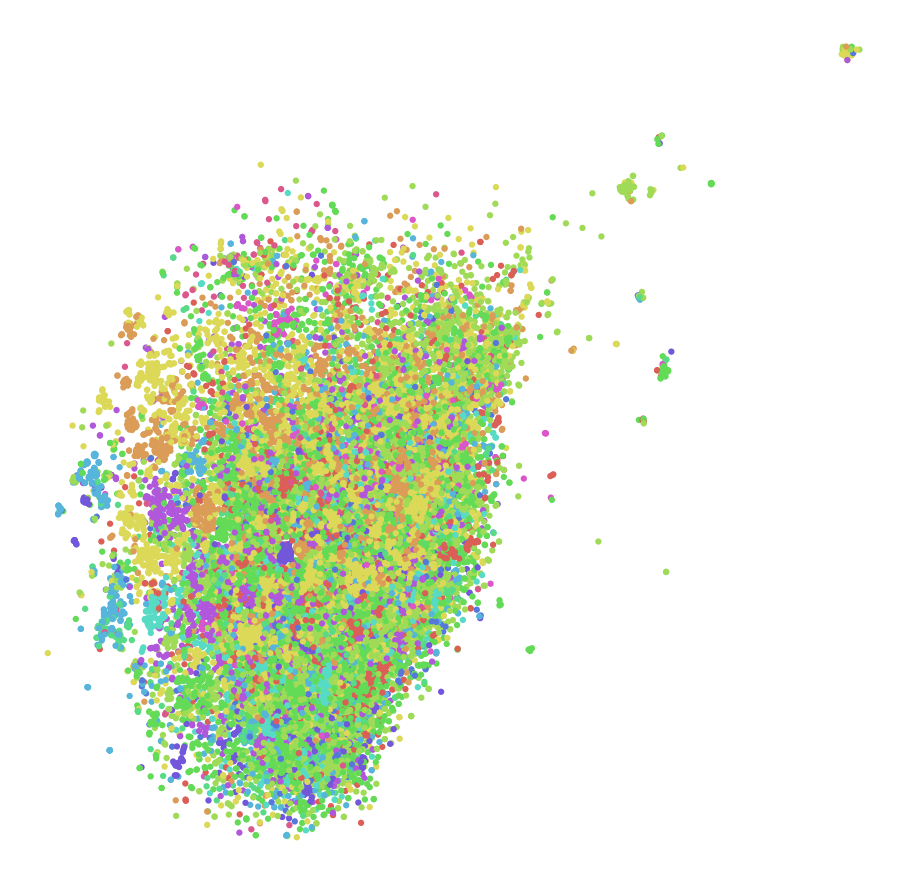

In [321]:
scatter(X_test_2d, np.array(colors), len(np.unique(colors)))

**visualize predicted test group data**

In [325]:
colors = get_colors_for_scatter(y_test_group_pred) # y_test_group_pred - predicted by one vs rest random forest model based on bow using interesting words

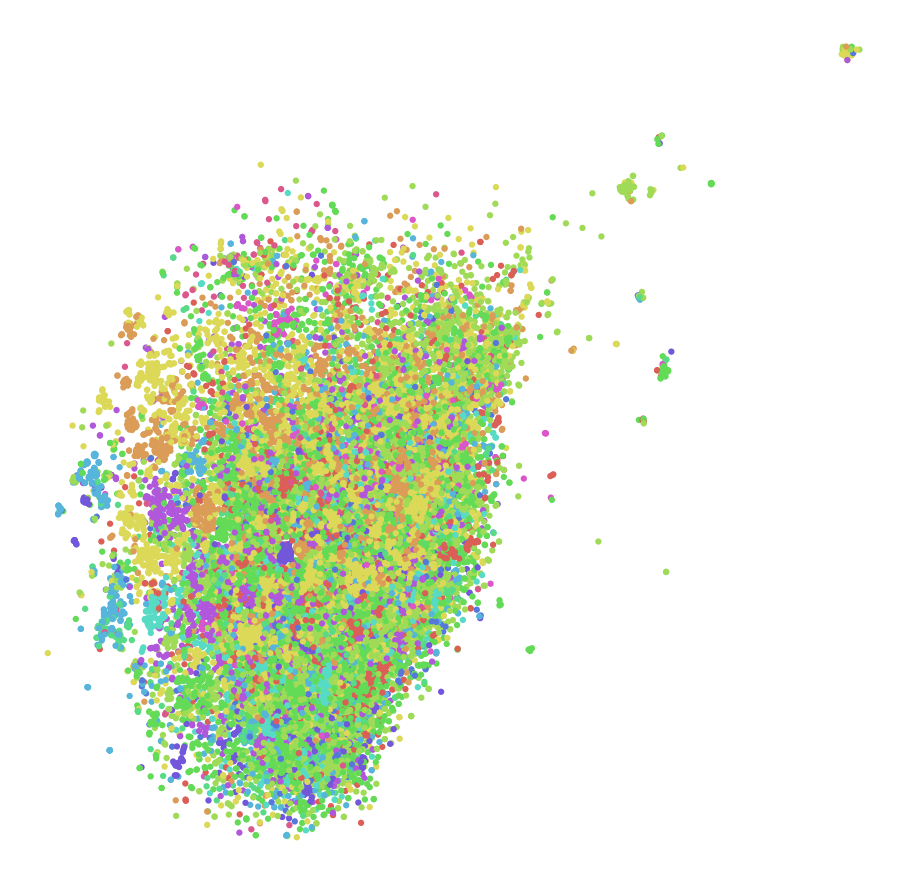

In [326]:
scatter(X_test_2d, np.array(colors), len(np.unique(colors)))

Basically, we can notice that points with same colors are similar between each other. However, there are several cases where we can some divergency. It can caused by reson that these embeddings vectors are not so good (fitted) for this domain. 

## HW: 11 - Deep Learning 

In [288]:
import tensorflow as tf
import numpy as np
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

In [289]:
import gensim

In [4]:
ft_1551 = gensim.models.fasttext.FastText.load("data/1551.cc.uk.300.bin")

Here, we try to use advanced deep learning technique to improve existing solution. 

In [14]:
X_train_tokens, X_val_tokens, y_train, y_val = train_test_split(X_train_tokens, y_train, test_size=0.20, random_state=42)

In [50]:
from sklearn.feature_extraction.text import CountVectorizer

In [54]:
# vectorizer = CountVectorizer(tokenizer=dummy)
# vectorizer.fit(X_train_tokens)

In [ ]:
oov_tok = 'unk'

In [114]:
# word_idx = {oov_tok : 1}
# for word in vectorizer.get_feature_names():
#     word_idx[word] = len(word_idx) + 1

In [ ]:
# ft_1551.wv

In [15]:
# word_idx = dict()
# for key in ft_1551.wv.vocab.keys():
#     word_idx[key] = len(word_idx)

In [147]:
embedding_matrix = [np.array(300 * [0.0])]
word_idx = {'pad' : 0}
for doc in X_train_tokens:
    for token in doc:
        if token not in word_idx:
            if token in ft_1551.wv:
                word_idx[token] = len(word_idx)
                embedding_matrix.append(ft_1551.wv[token])

In [148]:
embedding_matrix = np.array(embedding_matrix)

In [149]:
len(word_idx)

25727

In [265]:
def tokens2sequence(tokens, word_idx):
    seq = []
    for token in tokens:
        if token in word_idx:
            seq.append(word_idx[token])
#         else:
#             seq.append(word_idx[oov_tok])
    return seq

In [266]:
train_sequences = [tokens2sequence(doc, word_idx) for doc in X_train_tokens]

In [267]:
val_sequences = [tokens2sequence(doc, word_idx) for doc in X_val_tokens]

In [268]:
test_sequences = [tokens2sequence(doc, word_idx) for doc in X_test_tokens]

In [269]:
max_length = 30
trunc_type = 'post'
padding_type = 'post'

In [270]:
train_padded = pad_sequences(train_sequences, maxlen=max_length, padding=padding_type, truncating=trunc_type)

In [271]:
val_padded = pad_sequences(val_sequences, maxlen=max_length, padding=padding_type, truncating=trunc_type)

In [272]:
test_padded = pad_sequences(test_sequences, maxlen=max_length, padding=padding_type, truncating=trunc_type)

In [158]:
train_padded[125]

array([1805,  290, 1806, 1807, 1640,  264, 1279,  414, 1245,  682,  226,
        336,  337, 1018, 1808,  627,  356,   77, 1809, 1810, 1631,  337,
       1811, 1047, 1812, 1813, 1814,  252, 1815,  479], dtype=int32)

In [290]:
label2idx = dict()
for yi in y_train:
    if yi not in label2idx:
        label2idx[yi] = len(label2idx)

In [291]:
n_classes = len(label2idx)
n_classes

125

In [292]:
training_label_seq = np.array([[label2idx[yi]] for yi in y_train])
validation_label_seq = np.array([[label2idx[yi]] for yi in y_val])
test_label_seq = np.array([[label2idx[yi]] for yi in y_test])

In [293]:
vocab_size = len(word_idx)
embedding_dim = 300

In [294]:
vocab_size

25727

In [295]:
# embedding_matrix = ft_1551.wv.vectors

In [296]:
embedding_matrix.shape

(25727, 300)

In [297]:
vocab_size

25727

In [298]:
from keras.initializers import Constant

In [299]:
embedding_layer = tf.keras.layers.Embedding(vocab_size,
                            embedding_dim,
#                             weights=[embedding_matrix],
                            embeddings_initializer=Constant(embedding_matrix),
                            input_length=max_length,
                            trainable=False)

In [300]:
len(train_padded)

32043

In [301]:
with tf.device('/gpu:0'):
    
    model = tf.keras.Sequential([
        # Add an Embedding layer expecting input vocab of size 5000, and output embedding dimension of size 64 we set at the top
        embedding_layer,
        tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(embedding_dim)),
    #    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(32)),
        # use ReLU in place of tanh function since they are very good alternatives of each other.
        tf.keras.layers.Dense(embedding_dim, activation='relu'),
        # Add a Dense layer with 6 units and softmax activation.
        # When we have multiple outputs, softmax convert outputs layers into a probability distribution.
        tf.keras.layers.Dense(125, activation='softmax')
    ])
    model.summary()


Model: "sequential_35"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_6 (Embedding)      (None, 30, 300)           7718100   
_________________________________________________________________
bidirectional_35 (Bidirectio (None, 600)               1442400   
_________________________________________________________________
dense_70 (Dense)             (None, 300)               180300    
_________________________________________________________________
dense_71 (Dense)             (None, 125)               37625     
Total params: 9,378,425
Trainable params: 1,660,325
Non-trainable params: 7,718,100
_________________________________________________________________


In [302]:
num_epochs = 100


In [303]:
with tf.device('/gpu:0'):
    model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

In [304]:
with tf.device('/gpu:0'):
    history = model.fit(train_padded, training_label_seq, epochs=num_epochs, validation_data=(val_padded, validation_label_seq), verbose=2)

Train on 32043 samples, validate on 8011 samples
Epoch 1/100
32043/32043 - 116s - loss: 1.7343 - acc: 0.5497 - val_loss: 1.2690 - val_acc: 0.6358
Epoch 2/100
32043/32043 - 116s - loss: 0.9052 - acc: 0.7284 - val_loss: 1.2516 - val_acc: 0.6450
Epoch 3/100
32043/32043 - 113s - loss: 0.5477 - acc: 0.8279 - val_loss: 1.3156 - val_acc: 0.6525
Epoch 4/100
32043/32043 - 113s - loss: 0.3473 - acc: 0.8909 - val_loss: 1.4770 - val_acc: 0.6500
Epoch 5/100
32043/32043 - 113s - loss: 0.2704 - acc: 0.9157 - val_loss: 1.5812 - val_acc: 0.6421
Epoch 6/100
32043/32043 - 113s - loss: 0.2443 - acc: 0.9235 - val_loss: 1.6534 - val_acc: 0.6449
Epoch 7/100
32043/32043 - 113s - loss: 0.2055 - acc: 0.9360 - val_loss: 1.7739 - val_acc: 0.6399
Epoch 8/100
32043/32043 - 113s - loss: 0.2003 - acc: 0.9401 - val_loss: 1.8431 - val_acc: 0.6555
Epoch 9/100
32043/32043 - 113s - loss: 0.1858 - acc: 0.9412 - val_loss: 1.9736 - val_acc: 0.6344
Epoch 10/100
32043/32043 - 113s - loss: 0.1861 - acc: 0.9426 - val_loss: 2.018

Epoch 85/100
32043/32043 - 113s - loss: 0.0969 - acc: 0.9693 - val_loss: 4.7681 - val_acc: 0.5998
Epoch 86/100
32043/32043 - 113s - loss: 0.1067 - acc: 0.9673 - val_loss: 4.6831 - val_acc: 0.6042
Epoch 87/100
32043/32043 - 113s - loss: 0.0972 - acc: 0.9719 - val_loss: 4.7276 - val_acc: 0.6027
Epoch 88/100
32043/32043 - 113s - loss: 0.0898 - acc: 0.9707 - val_loss: 4.8746 - val_acc: 0.6090
Epoch 89/100
32043/32043 - 113s - loss: 0.0964 - acc: 0.9705 - val_loss: 4.8126 - val_acc: 0.6032
Epoch 90/100
32043/32043 - 113s - loss: 0.0998 - acc: 0.9697 - val_loss: 4.8309 - val_acc: 0.6052
Epoch 91/100
32043/32043 - 113s - loss: 0.0917 - acc: 0.9706 - val_loss: 4.8934 - val_acc: 0.6083
Epoch 92/100
32043/32043 - 113s - loss: 0.0943 - acc: 0.9719 - val_loss: 5.0009 - val_acc: 0.6034
Epoch 93/100
32043/32043 - 113s - loss: 0.0929 - acc: 0.9713 - val_loss: 4.9327 - val_acc: 0.6003
Epoch 94/100
32043/32043 - 113s - loss: 0.0917 - acc: 0.9706 - val_loss: 4.9689 - val_acc: 0.6065
Epoch 95/100
32043/3

In [305]:
pred = model.predict(test_padded)
labels = list(label2idx.keys())
y_test_pred = [labels[idx] for idx in np.argmax(pred, -1)]

In [306]:
print(classification_report(y_test, y_test_pred))

                                                                                  precision    recall  f1-score   support

                                                                     Інші Подяки       0.52      0.58      0.55        95
                                              Інші технічні недоліки стану ліфту       0.52      0.52      0.52       210
                Аварійний, травмонебезпечний стан утримання об’єктів благоустрою       0.26      0.18      0.21        90
                                    Будівництво та реконструкція об’єктів освіти       0.51      0.48      0.49        44
                                  Будівництво/дооблаштування дитячого майданчику       0.68      0.70      0.69       204
                                Видалення аварійних, пошкоджених хворобами дерев       0.50      0.48      0.49       108
                                                      Вилов безпритульних тварин       0.71      0.71      0.71        35
                       

In [307]:
f1_score(y_test, y_test_pred, average='micro')

0.5953629267156006

### Use LSTM for each group

In [276]:
y_train_group = [get_group_by_label(label, group_labels) for label in y_train]
y_test_group = [get_group_by_label(label, group_labels) for label in y_test]
y_val_group = [get_group_by_label(label, group_labels) for label in y_val]

In [277]:
label2idx = dict()
for yi in y_train_group:
    if yi not in label2idx:
        label2idx[yi] = len(label2idx)

In [278]:
n_classes = len(label2idx)
n_classes

13

In [279]:
training_label_seq_group = np.array([[label2idx[yi]] for yi in y_train_group])
validation_label_seq_group = np.array([[label2idx[yi]] for yi in y_val_group])
test_label_seq_group = np.array([[label2idx[yi]] for yi in y_test_group])

In [283]:
model = tf.keras.Sequential([
    # Add an Embedding layer expecting input vocab of size 5000, and output embedding dimension of size 64 we set at the top
    embedding_layer,
    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(embedding_dim)),
#    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(32)),
    # use ReLU in place of tanh function since they are very good alternatives of each other.
    tf.keras.layers.Dense(embedding_dim, activation='relu'),
    # Add a Dense layer with 6 units and softmax activation.
    # When we have multiple outputs, softmax convert outputs layers into a probability distribution.
    tf.keras.layers.Dense(n_classes, activation='softmax')
])
model.summary()


Model: "sequential_34"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_5 (Embedding)      (None, 30, 300)           7718100   
_________________________________________________________________
bidirectional_34 (Bidirectio (None, 600)               1442400   
_________________________________________________________________
dense_68 (Dense)             (None, 300)               180300    
_________________________________________________________________
dense_69 (Dense)             (None, 13)                3913      
Total params: 9,344,713
Trainable params: 1,626,613
Non-trainable params: 7,718,100
_________________________________________________________________


In [284]:
model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

In [285]:
history = model.fit(train_padded, training_label_seq_group, epochs=num_epochs, validation_data=(val_padded, validation_label_seq_group), verbose=2)

Train on 32043 samples, validate on 8011 samples
Epoch 1/10
32043/32043 - 119s - loss: 0.6514 - acc: 0.7839 - val_loss: 0.5279 - val_acc: 0.8227
Epoch 2/10
32043/32043 - 113s - loss: 0.3483 - acc: 0.8816 - val_loss: 0.5506 - val_acc: 0.8271
Epoch 3/10
32043/32043 - 114s - loss: 0.2123 - acc: 0.9269 - val_loss: 0.5861 - val_acc: 0.8359
Epoch 4/10
32043/32043 - 113s - loss: 0.1490 - acc: 0.9493 - val_loss: 0.7157 - val_acc: 0.8292
Epoch 5/10
32043/32043 - 114s - loss: 0.1138 - acc: 0.9616 - val_loss: 0.7566 - val_acc: 0.8281
Epoch 6/10
32043/32043 - 114s - loss: 0.1025 - acc: 0.9652 - val_loss: 0.7824 - val_acc: 0.8249
Epoch 7/10
32043/32043 - 114s - loss: 0.0881 - acc: 0.9689 - val_loss: 0.8808 - val_acc: 0.8245
Epoch 8/10
32043/32043 - 114s - loss: 0.0851 - acc: 0.9714 - val_loss: 0.9027 - val_acc: 0.8205
Epoch 9/10
32043/32043 - 113s - loss: 0.0774 - acc: 0.9730 - val_loss: 0.9657 - val_acc: 0.8194
Epoch 10/10
32043/32043 - 113s - loss: 0.0643 - acc: 0.9780 - val_loss: 1.0047 - val_ac

In [286]:
pred = model.predict(test_padded)
labels = list(label2idx.keys())
y_test_pred_group = [labels[idx] for idx in np.argmax(pred, -1)]

In [287]:
print(classification_report(y_test_group, y_test_pred_group))

              precision    recall  f1-score   support

   advertise       0.86      0.84      0.85       268
animal_plant       0.80      0.90      0.85       388
    building       0.75      0.75      0.75      3453
    cleaning       0.75      0.76      0.75       981
  drive_road       0.83      0.81      0.82       863
    elevator       0.95      0.95      0.95       742
   gratitude       0.78      0.76      0.77       127
  green_zone       0.58      0.40      0.47       257
     heating       0.88      0.86      0.87      1672
       light       0.88      0.90      0.89      1152
     rubbish       0.74      0.76      0.75       490
      street       0.82      0.83      0.82      3273
       water       0.88      0.89      0.89      3500

    accuracy                           0.83     17166
   macro avg       0.81      0.80      0.80     17166
weighted avg       0.82      0.83      0.83     17166



### Use LSTM for each group

In this case we can use the embeddings matrix

In [308]:
class CustomModel:
    
    max_length = 30
    trunc_type = 'post'
    padding_type = 'post'
        
    def __init__(self, embedding_layer, embedding_dim, word_idx, n_classes):
        self.word_idx = word_idx
        
        self.model = tf.keras.Sequential([
    # Add an Embedding layer expecting input vocab of size 5000, and output embedding dimension of size 64 we set at the top
            embedding_layer,
            tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(embedding_dim)),
#    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(32)),
    # use ReLU in place of tanh function since they are very good alternatives of each other.
            tf.keras.layers.Dense(embedding_dim, activation='relu'),
    # Add a Dense layer with 6 units and softmax activation.
    # When we have multiple outputs, softmax convert outputs layers into a probability distribution.
            tf.keras.layers.Dense(n_classes, activation='softmax')
        ])
        self.model.summary()
        self.label2idx = None
    
    
    def train(self, X_train_tokens, y_train, X_val_tokens, y_val, n_epochs=num_epochs):
        train_sequences = [tokens2sequence(doc, self.word_idx) for doc in X_train_tokens]
        val_sequences = [tokens2sequence(doc, self.word_idx) for doc in X_val_tokens]
        
        train_padded = pad_sequences(train_sequences, maxlen=self.max_length, padding=self.padding_type, truncating=self.trunc_type)
        val_padded = pad_sequences(val_sequences, maxlen=self.max_length, padding=self.padding_type, truncating=self.trunc_type)
        
        self.label2idx = self.calc_label2idx(y_train)
        training_label_seq = np.array([[self.label2idx[yi]] for yi in y_train])
        val_label_seq = np.array([[self.label2idx[yi]] for yi in y_val])
        
        self.model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
        self.model.fit(train_padded, training_label_seq, epochs=num_epochs, validation_data=(val_padded, val_label_seq), verbose=2)
        
        
    
    def predict(self, X_test_tokens):
        test_sequences = [tokens2sequence(doc, self.word_idx) for doc in X_test_tokens]
        test_padded = pad_sequences(test_sequences, maxlen=self.max_length, padding=self.padding_type, truncating=self.trunc_type)
        
        
        pred = self.model.predict(test_padded)
        
#         if self.label2idx is None:
#             self.label2idx = self.calc_label2idx(y_train)
        labels = list(self.label2idx.keys())
        y_test_pred = [labels[idx] for idx in np.argmax(pred, -1)]
        return y_test_pred
        
        
        
        
    
    def calc_label2idx(self, y):
        label2idx = dict()
        
        for yi in y:
            if yi not in label2idx:
                label2idx[yi] = len(label2idx)
        return label2idx


In [309]:
np.unique(y_train).shape[0]

125

In [310]:
group_model_dict = dict()
for group in groupped_data_train:
    x_train_tokens = groupped_data_train[group]['text']
    y_train_label = groupped_data_train[group]['label']
    n_classes = np.unique(y_train_label).shape[0]
    
    custom_model = CustomModel(embedding_layer, embedding_dim, word_idx, n_classes)
    
    x_train_tokens, x_val_tokens, y_train_label, y_val_label = train_test_split(x_train_tokens, y_train_label, test_size=0.20, random_state=42)
    custom_model.train(x_train_tokens, y_train_label, x_val_tokens, y_val_label)
    
    group_model_dict[group] = custom_model
    

Model: "sequential_36"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_6 (Embedding)      (None, 30, 300)           7718100   
_________________________________________________________________
bidirectional_36 (Bidirectio (None, 600)               1442400   
_________________________________________________________________
dense_72 (Dense)             (None, 300)               180300    
_________________________________________________________________
dense_73 (Dense)             (None, 18)                5418      
Total params: 9,346,218
Trainable params: 1,628,118
Non-trainable params: 7,718,100
_________________________________________________________________
Train on 5313 samples, validate on 1329 samples
Epoch 1/100
5313/5313 - 20s - loss: 1.0098 - acc: 0.7030 - val_loss: 0.7650 - val_acc: 0.7532
Epoch 2/100
5313/5313 - 19s - loss: 0.3705 - acc: 0.8859 - val_loss: 0.7293 - val_acc: 0.77

Epoch 78/100
5313/5313 - 19s - loss: 0.0103 - acc: 0.9960 - val_loss: 1.7540 - val_acc: 0.7502
Epoch 79/100
5313/5313 - 19s - loss: 0.0099 - acc: 0.9968 - val_loss: 1.7329 - val_acc: 0.7494
Epoch 80/100
5313/5313 - 19s - loss: 0.0092 - acc: 0.9966 - val_loss: 1.8206 - val_acc: 0.7464
Epoch 81/100
5313/5313 - 19s - loss: 0.0097 - acc: 0.9968 - val_loss: 1.7886 - val_acc: 0.7502
Epoch 82/100
5313/5313 - 19s - loss: 0.0104 - acc: 0.9966 - val_loss: 1.7779 - val_acc: 0.7479
Epoch 83/100
5313/5313 - 19s - loss: 0.0097 - acc: 0.9966 - val_loss: 1.8035 - val_acc: 0.7532
Epoch 84/100
5313/5313 - 19s - loss: 0.0099 - acc: 0.9962 - val_loss: 1.7958 - val_acc: 0.7517
Epoch 85/100
5313/5313 - 19s - loss: 0.0100 - acc: 0.9964 - val_loss: 1.8167 - val_acc: 0.7494
Epoch 86/100
5313/5313 - 19s - loss: 0.0102 - acc: 0.9966 - val_loss: 1.8237 - val_acc: 0.7524
Epoch 87/100
5313/5313 - 19s - loss: 0.0088 - acc: 0.9966 - val_loss: 1.8363 - val_acc: 0.7547
Epoch 88/100
5313/5313 - 19s - loss: 0.0097 - acc:

Epoch 55/100
1189/1189 - 4s - loss: 0.0048 - acc: 0.9958 - val_loss: 1.7893 - val_acc: 0.6510
Epoch 56/100
1189/1189 - 4s - loss: 0.0045 - acc: 0.9950 - val_loss: 1.7927 - val_acc: 0.6477
Epoch 57/100
1189/1189 - 4s - loss: 0.0049 - acc: 0.9958 - val_loss: 1.8081 - val_acc: 0.6443
Epoch 58/100
1189/1189 - 4s - loss: 0.0055 - acc: 0.9975 - val_loss: 1.8273 - val_acc: 0.6443
Epoch 59/100
1189/1189 - 4s - loss: 0.0046 - acc: 0.9966 - val_loss: 1.8102 - val_acc: 0.6544
Epoch 60/100
1189/1189 - 5s - loss: 0.0046 - acc: 0.9966 - val_loss: 1.8128 - val_acc: 0.6544
Epoch 61/100
1189/1189 - 4s - loss: 0.0043 - acc: 0.9966 - val_loss: 1.8124 - val_acc: 0.6510
Epoch 62/100
1189/1189 - 4s - loss: 0.0042 - acc: 0.9975 - val_loss: 1.8149 - val_acc: 0.6544
Epoch 63/100
1189/1189 - 4s - loss: 0.0043 - acc: 0.9958 - val_loss: 1.8232 - val_acc: 0.6477
Epoch 64/100
1189/1189 - 4s - loss: 0.0050 - acc: 0.9958 - val_loss: 1.8402 - val_acc: 0.6510
Epoch 65/100
1189/1189 - 4s - loss: 0.0042 - acc: 0.9966 - v

Epoch 32/100
5086/5086 - 18s - loss: 0.0053 - acc: 0.9969 - val_loss: 1.5579 - val_acc: 0.7280
Epoch 33/100
5086/5086 - 18s - loss: 0.0055 - acc: 0.9969 - val_loss: 1.5633 - val_acc: 0.7264
Epoch 34/100
5086/5086 - 18s - loss: 0.0053 - acc: 0.9972 - val_loss: 1.5746 - val_acc: 0.7288
Epoch 35/100
5086/5086 - 18s - loss: 0.0051 - acc: 0.9974 - val_loss: 1.5749 - val_acc: 0.7296
Epoch 36/100
5086/5086 - 18s - loss: 0.0052 - acc: 0.9969 - val_loss: 1.6131 - val_acc: 0.7225
Epoch 37/100
5086/5086 - 18s - loss: 0.0052 - acc: 0.9976 - val_loss: 1.5894 - val_acc: 0.7296
Epoch 38/100
5086/5086 - 18s - loss: 0.0050 - acc: 0.9976 - val_loss: 1.6017 - val_acc: 0.7288
Epoch 39/100
5086/5086 - 18s - loss: 0.0049 - acc: 0.9972 - val_loss: 1.6313 - val_acc: 0.7272
Epoch 40/100
5086/5086 - 18s - loss: 0.0051 - acc: 0.9971 - val_loss: 1.6114 - val_acc: 0.7319
Epoch 41/100
5086/5086 - 18s - loss: 0.0047 - acc: 0.9967 - val_loss: 1.6277 - val_acc: 0.7303
Epoch 42/100
5086/5086 - 18s - loss: 0.0046 - acc:

Epoch 9/100
570/570 - 2s - loss: 0.0090 - acc: 0.9982 - val_loss: 1.1893 - val_acc: 0.6853
Epoch 10/100
570/570 - 2s - loss: 0.0085 - acc: 0.9982 - val_loss: 1.0931 - val_acc: 0.6923
Epoch 11/100
570/570 - 2s - loss: 0.0053 - acc: 0.9982 - val_loss: 1.0889 - val_acc: 0.6923
Epoch 12/100
570/570 - 2s - loss: 0.0045 - acc: 0.9982 - val_loss: 1.1041 - val_acc: 0.6923
Epoch 13/100
570/570 - 2s - loss: 0.0041 - acc: 0.9982 - val_loss: 1.1262 - val_acc: 0.6853
Epoch 14/100
570/570 - 2s - loss: 0.0030 - acc: 0.9982 - val_loss: 1.1338 - val_acc: 0.6993
Epoch 15/100
570/570 - 2s - loss: 0.0035 - acc: 0.9965 - val_loss: 1.1511 - val_acc: 0.7063
Epoch 16/100
570/570 - 2s - loss: 0.0043 - acc: 0.9982 - val_loss: 1.1613 - val_acc: 0.7063
Epoch 17/100
570/570 - 2s - loss: 0.0063 - acc: 0.9982 - val_loss: 1.1946 - val_acc: 0.6993
Epoch 18/100
570/570 - 2s - loss: 0.0034 - acc: 0.9982 - val_loss: 1.1647 - val_acc: 0.7133
Epoch 19/100
570/570 - 2s - loss: 0.0034 - acc: 0.9982 - val_loss: 1.1788 - val_a

570/570 - 2s - loss: 0.0029 - acc: 0.9982 - val_loss: 1.5303 - val_acc: 0.7203
Epoch 99/100
570/570 - 2s - loss: 0.0026 - acc: 0.9982 - val_loss: 1.5368 - val_acc: 0.7133
Epoch 100/100
570/570 - 2s - loss: 0.0031 - acc: 0.9982 - val_loss: 1.5452 - val_acc: 0.7063
Model: "sequential_40"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_6 (Embedding)      (None, 30, 300)           7718100   
_________________________________________________________________
bidirectional_40 (Bidirectio (None, 600)               1442400   
_________________________________________________________________
dense_80 (Dense)             (None, 300)               180300    
_________________________________________________________________
dense_81 (Dense)             (None, 7)                 2107      
Total params: 9,342,907
Trainable params: 1,624,807
Non-trainable params: 7,718,100
___________________________________

Epoch 76/100
2520/2520 - 9s - loss: 0.0073 - acc: 0.9960 - val_loss: 1.3235 - val_acc: 0.8019
Epoch 77/100
2520/2520 - 9s - loss: 0.0071 - acc: 0.9968 - val_loss: 1.3138 - val_acc: 0.8019
Epoch 78/100
2520/2520 - 9s - loss: 0.0063 - acc: 0.9968 - val_loss: 1.3820 - val_acc: 0.8003
Epoch 79/100
2520/2520 - 9s - loss: 0.0079 - acc: 0.9968 - val_loss: 1.3029 - val_acc: 0.7987
Epoch 80/100
2520/2520 - 9s - loss: 0.0082 - acc: 0.9964 - val_loss: 1.3354 - val_acc: 0.7987
Epoch 81/100
2520/2520 - 9s - loss: 0.0074 - acc: 0.9960 - val_loss: 1.3259 - val_acc: 0.7987
Epoch 82/100
2520/2520 - 9s - loss: 0.0065 - acc: 0.9964 - val_loss: 1.3672 - val_acc: 0.8003
Epoch 83/100
2520/2520 - 9s - loss: 0.0068 - acc: 0.9964 - val_loss: 1.3815 - val_acc: 0.8003
Epoch 84/100
2520/2520 - 9s - loss: 0.0069 - acc: 0.9968 - val_loss: 1.3862 - val_acc: 0.8003
Epoch 85/100
2520/2520 - 9s - loss: 0.0074 - acc: 0.9964 - val_loss: 1.3675 - val_acc: 0.7987
Epoch 86/100
2520/2520 - 9s - loss: 0.0072 - acc: 0.9960 - v

Epoch 54/100
1578/1578 - 6s - loss: 0.0203 - acc: 0.9911 - val_loss: 0.7481 - val_acc: 0.8608
Epoch 55/100
1578/1578 - 6s - loss: 0.0196 - acc: 0.9899 - val_loss: 0.7455 - val_acc: 0.8608
Epoch 56/100
1578/1578 - 6s - loss: 0.0194 - acc: 0.9905 - val_loss: 0.7586 - val_acc: 0.8608
Epoch 57/100
1578/1578 - 6s - loss: 0.0197 - acc: 0.9905 - val_loss: 0.7644 - val_acc: 0.8582
Epoch 58/100
1578/1578 - 6s - loss: 0.0197 - acc: 0.9905 - val_loss: 0.7749 - val_acc: 0.8582
Epoch 59/100
1578/1578 - 6s - loss: 0.0200 - acc: 0.9905 - val_loss: 0.7498 - val_acc: 0.8633
Epoch 60/100
1578/1578 - 6s - loss: 0.0204 - acc: 0.9905 - val_loss: 0.7563 - val_acc: 0.8608
Epoch 61/100
1578/1578 - 6s - loss: 0.0203 - acc: 0.9905 - val_loss: 0.7496 - val_acc: 0.8608
Epoch 62/100
1578/1578 - 6s - loss: 0.0197 - acc: 0.9892 - val_loss: 0.7750 - val_acc: 0.8582
Epoch 63/100
1578/1578 - 6s - loss: 0.0196 - acc: 0.9905 - val_loss: 0.7849 - val_acc: 0.8557
Epoch 64/100
1578/1578 - 6s - loss: 0.0205 - acc: 0.9905 - v

Epoch 31/100
4775/4775 - 17s - loss: 0.0022 - acc: 0.9992 - val_loss: 1.5100 - val_acc: 0.7328
Epoch 32/100
4775/4775 - 17s - loss: 0.0021 - acc: 0.9990 - val_loss: 1.5206 - val_acc: 0.7320
Epoch 33/100
4775/4775 - 17s - loss: 0.0021 - acc: 0.9987 - val_loss: 1.5552 - val_acc: 0.7328
Epoch 34/100
4775/4775 - 17s - loss: 0.0022 - acc: 0.9987 - val_loss: 1.5461 - val_acc: 0.7312
Epoch 35/100
4775/4775 - 17s - loss: 0.0020 - acc: 0.9987 - val_loss: 1.5593 - val_acc: 0.7320
Epoch 36/100
4775/4775 - 17s - loss: 0.0021 - acc: 0.9990 - val_loss: 1.5800 - val_acc: 0.7345
Epoch 37/100
4775/4775 - 17s - loss: 0.0019 - acc: 0.9990 - val_loss: 1.5901 - val_acc: 0.7328
Epoch 38/100
4775/4775 - 17s - loss: 0.0020 - acc: 0.9987 - val_loss: 1.5999 - val_acc: 0.7312
Epoch 39/100
4775/4775 - 17s - loss: 0.0020 - acc: 0.9987 - val_loss: 1.5979 - val_acc: 0.7337
Epoch 40/100
4775/4775 - 17s - loss: 0.0019 - acc: 0.9987 - val_loss: 1.6204 - val_acc: 0.7328
Epoch 41/100
4775/4775 - 17s - loss: 0.0019 - acc:

Epoch 8/100
1745/1745 - 6s - loss: 0.0508 - acc: 0.9828 - val_loss: 1.5275 - val_acc: 0.5538
Epoch 9/100
1745/1745 - 7s - loss: 0.0511 - acc: 0.9742 - val_loss: 1.5854 - val_acc: 0.5652
Epoch 10/100
1745/1745 - 6s - loss: 0.0671 - acc: 0.9742 - val_loss: 1.4975 - val_acc: 0.5538
Epoch 11/100
1745/1745 - 6s - loss: 0.0716 - acc: 0.9754 - val_loss: 1.4595 - val_acc: 0.5744
Epoch 12/100
1745/1745 - 6s - loss: 0.0429 - acc: 0.9822 - val_loss: 1.6209 - val_acc: 0.5927
Epoch 13/100
1745/1745 - 6s - loss: 0.0511 - acc: 0.9794 - val_loss: 1.5686 - val_acc: 0.5744
Epoch 14/100
1745/1745 - 6s - loss: 0.0349 - acc: 0.9880 - val_loss: 1.6860 - val_acc: 0.5606
Epoch 15/100
1745/1745 - 6s - loss: 0.0429 - acc: 0.9817 - val_loss: 1.6229 - val_acc: 0.5767
Epoch 16/100
1745/1745 - 6s - loss: 0.0367 - acc: 0.9845 - val_loss: 1.6465 - val_acc: 0.5812
Epoch 17/100
1745/1745 - 6s - loss: 0.0363 - acc: 0.9828 - val_loss: 1.6616 - val_acc: 0.5835
Epoch 18/100
1745/1745 - 6s - loss: 0.0320 - acc: 0.9851 - val

Epoch 96/100
1745/1745 - 6s - loss: 0.0209 - acc: 0.9880 - val_loss: 2.2639 - val_acc: 0.5652
Epoch 97/100
1745/1745 - 6s - loss: 0.0206 - acc: 0.9874 - val_loss: 2.2723 - val_acc: 0.5789
Epoch 98/100
1745/1745 - 6s - loss: 0.0196 - acc: 0.9874 - val_loss: 2.2973 - val_acc: 0.5789
Epoch 99/100
1745/1745 - 6s - loss: 0.0197 - acc: 0.9874 - val_loss: 2.2644 - val_acc: 0.5744
Epoch 100/100
1745/1745 - 6s - loss: 0.0206 - acc: 0.9880 - val_loss: 2.2739 - val_acc: 0.5721
Model: "sequential_44"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_6 (Embedding)      (None, 30, 300)           7718100   
_________________________________________________________________
bidirectional_44 (Bidirectio (None, 600)               1442400   
_________________________________________________________________
dense_88 (Dense)             (None, 300)               180300    
____________________________________________

Epoch 74/100
1124/1124 - 4s - loss: 0.0076 - acc: 0.9973 - val_loss: 1.7322 - val_acc: 0.7117
Epoch 75/100
1124/1124 - 4s - loss: 0.0071 - acc: 0.9964 - val_loss: 1.7179 - val_acc: 0.7117
Epoch 76/100
1124/1124 - 4s - loss: 0.0071 - acc: 0.9964 - val_loss: 1.7219 - val_acc: 0.7082
Epoch 77/100
1124/1124 - 4s - loss: 0.0077 - acc: 0.9964 - val_loss: 1.7263 - val_acc: 0.7046
Epoch 78/100
1124/1124 - 4s - loss: 0.0071 - acc: 0.9973 - val_loss: 1.7330 - val_acc: 0.7153
Epoch 79/100
1124/1124 - 4s - loss: 0.0075 - acc: 0.9973 - val_loss: 1.7363 - val_acc: 0.7153
Epoch 80/100
1124/1124 - 4s - loss: 0.0073 - acc: 0.9964 - val_loss: 1.7330 - val_acc: 0.7082
Epoch 81/100
1124/1124 - 4s - loss: 0.0069 - acc: 0.9973 - val_loss: 1.7483 - val_acc: 0.7082
Epoch 82/100
1124/1124 - 4s - loss: 0.0073 - acc: 0.9964 - val_loss: 1.7574 - val_acc: 0.7117
Epoch 83/100
1124/1124 - 4s - loss: 0.0076 - acc: 0.9964 - val_loss: 1.7462 - val_acc: 0.7046
Epoch 84/100
1124/1124 - 4s - loss: 0.0072 - acc: 0.9964 - v

Epoch 51/100
377/377 - 1s - loss: 2.6425e-05 - acc: 1.0000 - val_loss: 0.8212 - val_acc: 0.8211
Epoch 52/100
377/377 - 1s - loss: 2.5384e-05 - acc: 1.0000 - val_loss: 0.8234 - val_acc: 0.8211
Epoch 53/100
377/377 - 1s - loss: 2.4411e-05 - acc: 1.0000 - val_loss: 0.8262 - val_acc: 0.8211
Epoch 54/100
377/377 - 1s - loss: 2.3437e-05 - acc: 1.0000 - val_loss: 0.8291 - val_acc: 0.8211
Epoch 55/100
377/377 - 1s - loss: 2.2562e-05 - acc: 1.0000 - val_loss: 0.8321 - val_acc: 0.8211
Epoch 56/100
377/377 - 1s - loss: 2.1750e-05 - acc: 1.0000 - val_loss: 0.8341 - val_acc: 0.8211
Epoch 57/100
377/377 - 1s - loss: 2.0946e-05 - acc: 1.0000 - val_loss: 0.8363 - val_acc: 0.8211
Epoch 58/100
377/377 - 1s - loss: 2.0235e-05 - acc: 1.0000 - val_loss: 0.8389 - val_acc: 0.8211
Epoch 59/100
377/377 - 1s - loss: 1.9512e-05 - acc: 1.0000 - val_loss: 0.8418 - val_acc: 0.8211
Epoch 60/100
377/377 - 1s - loss: 1.8858e-05 - acc: 1.0000 - val_loss: 0.8441 - val_acc: 0.8211
Epoch 61/100
377/377 - 1s - loss: 1.8220

Epoch 28/100
406/406 - 1s - loss: 0.0036 - acc: 0.9975 - val_loss: 2.1383 - val_acc: 0.5490
Epoch 29/100
406/406 - 1s - loss: 0.0043 - acc: 0.9975 - val_loss: 2.1538 - val_acc: 0.5490
Epoch 30/100
406/406 - 1s - loss: 0.0041 - acc: 0.9975 - val_loss: 2.1670 - val_acc: 0.5490
Epoch 31/100
406/406 - 1s - loss: 0.0037 - acc: 0.9975 - val_loss: 2.1847 - val_acc: 0.5588
Epoch 32/100
406/406 - 1s - loss: 0.0038 - acc: 0.9975 - val_loss: 2.2011 - val_acc: 0.5588
Epoch 33/100
406/406 - 1s - loss: 0.0049 - acc: 0.9951 - val_loss: 2.2186 - val_acc: 0.5490
Epoch 34/100
406/406 - 1s - loss: 0.0038 - acc: 0.9975 - val_loss: 2.2282 - val_acc: 0.5588
Epoch 35/100
406/406 - 1s - loss: 0.0041 - acc: 0.9951 - val_loss: 2.2419 - val_acc: 0.5588
Epoch 36/100
406/406 - 1s - loss: 0.0036 - acc: 0.9975 - val_loss: 2.2617 - val_acc: 0.5588
Epoch 37/100
406/406 - 1s - loss: 0.0037 - acc: 0.9975 - val_loss: 2.2747 - val_acc: 0.5588
Epoch 38/100
406/406 - 1s - loss: 0.0035 - acc: 0.9975 - val_loss: 2.2912 - val_

Epoch 7/100
740/740 - 3s - loss: 0.0013 - acc: 1.0000 - val_loss: 0.7219 - val_acc: 0.7838
Epoch 8/100
740/740 - 3s - loss: 8.8506e-04 - acc: 1.0000 - val_loss: 0.7296 - val_acc: 0.7946
Epoch 9/100
740/740 - 3s - loss: 6.5530e-04 - acc: 1.0000 - val_loss: 0.7352 - val_acc: 0.8054
Epoch 10/100
740/740 - 3s - loss: 5.3365e-04 - acc: 1.0000 - val_loss: 0.7378 - val_acc: 0.8054
Epoch 11/100
740/740 - 3s - loss: 4.3075e-04 - acc: 1.0000 - val_loss: 0.7454 - val_acc: 0.8000
Epoch 12/100
740/740 - 3s - loss: 3.6197e-04 - acc: 1.0000 - val_loss: 0.7518 - val_acc: 0.8000
Epoch 13/100
740/740 - 3s - loss: 3.0900e-04 - acc: 1.0000 - val_loss: 0.7563 - val_acc: 0.8000
Epoch 14/100
740/740 - 3s - loss: 2.6884e-04 - acc: 1.0000 - val_loss: 0.7607 - val_acc: 0.8000
Epoch 15/100
740/740 - 3s - loss: 2.3381e-04 - acc: 1.0000 - val_loss: 0.7652 - val_acc: 0.8108
Epoch 16/100
740/740 - 3s - loss: 2.0647e-04 - acc: 1.0000 - val_loss: 0.7708 - val_acc: 0.8108
Epoch 17/100
740/740 - 3s - loss: 1.8228e-04 - 

Epoch 93/100
740/740 - 3s - loss: 5.7223e-06 - acc: 1.0000 - val_loss: 0.9526 - val_acc: 0.8270
Epoch 94/100
740/740 - 3s - loss: 5.5584e-06 - acc: 1.0000 - val_loss: 0.9544 - val_acc: 0.8270
Epoch 95/100
740/740 - 3s - loss: 5.4279e-06 - acc: 1.0000 - val_loss: 0.9559 - val_acc: 0.8270
Epoch 96/100
740/740 - 3s - loss: 5.3043e-06 - acc: 1.0000 - val_loss: 0.9574 - val_acc: 0.8270
Epoch 97/100
740/740 - 3s - loss: 5.1875e-06 - acc: 1.0000 - val_loss: 0.9588 - val_acc: 0.8270
Epoch 98/100
740/740 - 3s - loss: 5.0659e-06 - acc: 1.0000 - val_loss: 0.9607 - val_acc: 0.8270
Epoch 99/100
740/740 - 3s - loss: 4.9445e-06 - acc: 1.0000 - val_loss: 0.9622 - val_acc: 0.8270
Epoch 100/100
740/740 - 3s - loss: 4.8414e-06 - acc: 1.0000 - val_loss: 0.9640 - val_acc: 0.8270
Model: "sequential_48"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_6 (Embedding)      (None, 30, 300)           7718100   
__________

Epoch 69/100
206/206 - 1s - loss: 1.8857e-05 - acc: 1.0000 - val_loss: 0.9247 - val_acc: 0.8269
Epoch 70/100
206/206 - 1s - loss: 1.8319e-05 - acc: 1.0000 - val_loss: 0.9261 - val_acc: 0.8269
Epoch 71/100
206/206 - 1s - loss: 1.7797e-05 - acc: 1.0000 - val_loss: 0.9279 - val_acc: 0.8269
Epoch 72/100
206/206 - 1s - loss: 1.7295e-05 - acc: 1.0000 - val_loss: 0.9294 - val_acc: 0.8269
Epoch 73/100
206/206 - 1s - loss: 1.6846e-05 - acc: 1.0000 - val_loss: 0.9308 - val_acc: 0.8269
Epoch 74/100
206/206 - 1s - loss: 1.6355e-05 - acc: 1.0000 - val_loss: 0.9327 - val_acc: 0.8269
Epoch 75/100
206/206 - 1s - loss: 1.5950e-05 - acc: 1.0000 - val_loss: 0.9345 - val_acc: 0.8269
Epoch 76/100
206/206 - 1s - loss: 1.5498e-05 - acc: 1.0000 - val_loss: 0.9364 - val_acc: 0.8269
Epoch 77/100
206/206 - 1s - loss: 1.5099e-05 - acc: 1.0000 - val_loss: 0.9380 - val_acc: 0.8269
Epoch 78/100
206/206 - 1s - loss: 1.4656e-05 - acc: 1.0000 - val_loss: 0.9397 - val_acc: 0.8269
Epoch 79/100
206/206 - 1s - loss: 1.4315

In [311]:
report_result_dict  = dict()
y_test_pred_all, y_test_all = [], []
for group in group_model_dict:
    group_data = groupped_data_test[group]

    model = group_model_dict[group]
    X_test_tmp = group_data['text']
    y_test_tmp = group_data['label']
        
#     label2idx_tmp = model.calc_label2idx(y_test_tmp)
    y_test_pred_tmp = model.predict(X_test_tmp) #predict(model.model, X_test_tmp, label2idx_tmp)

    
    report = classification_report(group_data['label'], y_test_pred_tmp)
    
    report_result_dict[group] = report
    
    y_test_all += y_test_tmp
    y_test_pred_all += y_test_pred_tmp

In [312]:
for group in report_result_dict:
    print("#################################################")
    print(group)
    print(report_result_dict[group])

#################################################
water
                                                                                  precision    recall  f1-score   support

                      Встановлення та експлуатація лічильників на водопостачання       0.80      0.85      0.82       114
                                                                    Відсутнє ХВП       0.73      0.66      0.69       236
                   Відсутній тиск ХВП до 9-го поверху включно (”Київводоканал” )       0.56      0.40      0.47        35
                       Відсутній тиск ХВП з 10-го поверху включно (”Київенерго”)       0.45      0.36      0.40        42
                                                                 Відсутність ГВП       0.85      0.94      0.89      1955
                                                                 Не працює бювет       0.96      0.86      0.91        81
                                                            Недостатній тиск ГВП       0.

In [313]:
print(classification_report(y_test_all, y_test_pred_all))

                                                                                  precision    recall  f1-score   support

                                                                     Інші Подяки       0.85      0.86      0.86        95
                                              Інші технічні недоліки стану ліфту       0.56      0.59      0.57       210
                Аварійний, травмонебезпечний стан утримання об’єктів благоустрою       0.57      0.34      0.43        90
                                    Будівництво та реконструкція об’єктів освіти       0.66      0.61      0.64        44
                                  Будівництво/дооблаштування дитячого майданчику       0.70      0.78      0.74       204
                                Видалення аварійних, пошкоджених хворобами дерев       0.62      0.78      0.69       108
                                                      Вилов безпритульних тварин       0.89      0.97      0.93        35
                       

In the table above, we assume that we know exactly group classifier and detect sub-groups. As we can the result with LSTM improved well. F1-score (macro-avg) = 0.66 > 0.59

*Let's evaluate full result with model for group classification and model (LSTM) for sub-group*

In [314]:
full_classifier = ClassifierViaGroup(ovr_clf, group_model_dict, interesting_word_idx_dict)

In [315]:
y_test_group_pred, y_test_pred = full_classifier.predict_processed_docs(X_test_tokens)

In [316]:
print(classification_report(y_test_group, y_test_group_pred))

              precision    recall  f1-score   support

   advertise       0.85      0.81      0.83       268
animal_plant       0.88      0.87      0.88       388
    building       0.78      0.75      0.76      3453
    cleaning       0.80      0.76      0.78       981
  drive_road       0.87      0.81      0.84       863
    elevator       0.95      0.96      0.96       742
   gratitude       0.90      0.49      0.63       127
  green_zone       0.81      0.36      0.50       257
     heating       0.87      0.88      0.88      1672
       light       0.90      0.91      0.90      1152
     rubbish       0.76      0.79      0.78       490
      street       0.80      0.86      0.83      3273
       water       0.87      0.91      0.89      3500

    accuracy                           0.84     17166
   macro avg       0.85      0.78      0.80     17166
weighted avg       0.84      0.84      0.83     17166



In [317]:
print(classification_report(y_test, y_test_pred))

                                                                                  precision    recall  f1-score   support

                                                                     Інші Подяки       0.78      0.40      0.53        95
                                              Інші технічні недоліки стану ліфту       0.52      0.57      0.54       210
                Аварійний, травмонебезпечний стан утримання об’єктів благоустрою       0.36      0.28      0.31        90
                                    Будівництво та реконструкція об’єктів освіти       0.71      0.57      0.63        44
                                  Будівництво/дооблаштування дитячого майданчику       0.66      0.77      0.71       204
                                Видалення аварійних, пошкоджених хворобами дерев       0.61      0.72      0.66       108
                                                      Вилов безпритульних тварин       0.73      0.91      0.81        35
                       

F1-scre: 0.54 > 0.46